In [1]:
import sys
import matplotlib.animation
print matplotlib.animation.writers.list()
print sys.path

sys.path.insert(0,'/home/antolikjan/projects/mozaikold/contrib')
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/neo')
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik')
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib')
import lsv1m_paper
import mozaik
from mozaik.controller import run_workflow, setup_logging
from mozaik.storage.datastore import Hdf5DataStore,PickledDataStore
from parameters import ParameterSet
from mozaik.visualization.plotting import *

from mozaik.analysis.technical import NeuronAnnotationsToPerNeuronValues
from mozaik.tools.mozaik_parametrized import colapse, colapse_to_dictionary, MozaikParametrized
from mozaik.analysis.analysis import *
from mozaik.analysis.vision import *
from mozaik.storage.queries import *
from mozaik.visualization.helper_functions import *

import sys
#sys.path.append('/home/jan/cluster_UNIC/mozaik/contrib/')
#sys.path.append('/home/jan/cluster_UNIC/mozaik/contrib/PushPullCCLISSOMModelSSIzL23')
#from analysis_and_visualization import perform_analysis_and_visualization
%matplotlib inline

setup_logging()

#data_store = PickledDataStore(load=True,parameters=ParameterSet({'root_directory':'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib/New/20180416-011035[param_small_norand.defaults]CombinationParamSearch{12}/SelfSustainedPushPull_ParameterSearch_____sigma:1.4_sigma:1.4_base_weight:0.0012_num_samples:100_size:0.17_base_weight:0.001_base_weight:0.0009_inhibitory_connection_ratio:0.8_e_rev_I:-80_tau_syn_I:2.5_base_weight:0.0015_stdev:2.4','store_stimuli': False}),replace=True)

#data_store = PickledDataStore(load=True,parameters=ParameterSet({'root_directory':'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib/New/20180605-104711[new_std_orf_large.defaults]CombinationParamSearch{13}/SelfSustainedPushPull_ParameterSearch_____sigma:3.0_base_weight:0.0012_base_weight:0.0007_tau_rec:50_sigma:1.2_base_weight:0.0013_sigma:2.0_layer23_aff_ratio:0.2_tau_syn_E:7.0_tau_syn_I:13.0_v_thresh:-54_base_weight:0.0027_stdev:2.2','store_stimuli': False}),replace=True)


#data_store = PickledDataStore(load=True,parameters=ParameterSet({'root_directory':'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib/New/20180716-133845[new_std_orf_large.defaults]CombinationParamSearch{13}/SelfSustainedPushPull_ParameterSearch_____sigma:1.2_base_weight:0.0014_size:0.17_K:1000_base_weight:0.0012_sigma:2.0_layer23_aff_ratio:0.25_tau_m:15.0_tau_syn_I:12.0_v_thresh:-54_density:2000_base_weight:0.0027_stdev:2.2','store_stimuli': False}),replace=True)


#THE PAPER
data_store = PickledDataStore(load=True,parameters=ParameterSet({'root_directory':'/home/antolikjan/DATA/LSV1M_FINAL/OR_SelfSustainedPushPull_ParameterSearch_____sigma:1.4_size:0.17_K:1000_base_weight:0.0005_tau_rec:30_base_weight:0.0009_tau_m:17.0_tau_syn_E:7.0_tau_syn_I:11.0_v_thresh:-53_density:1500_sx:4000_ExcInhAfferentRatio:1.0_base_weight:0.0021_stdev:2.2','store_stimuli': False}),replace=True)


#data_store = PickledDataStore(load=True,parameters=ParameterSet({'root_directory':'/home/antolikjan/projects/mozaikold/contrib/LSV1M_IDV/SelfSustainedPushPull_test_correct_circ_dist_____','store_stimuli': False}),replace=True)



NeuronAnnotationsToPerNeuronValues(data_store,ParameterSet({})).analyse()
analog_ids = param_filter_query(data_store,sheet_name="V1_Exc_L4").get_segments()[0].get_stored_esyn_ids()
analog_ids_inh = param_filter_query(data_store,sheet_name="V1_Inh_L4").get_segments()[0].get_stored_esyn_ids()
analog_ids23 = param_filter_query(data_store,sheet_name="V1_Exc_L2/3").get_segments()[0].get_stored_esyn_ids()
analog_ids_inh23 = param_filter_query(data_store,sheet_name="V1_Inh_L2/3").get_segments()[0].get_stored_esyn_ids()

#find neuron with preference closet to 0  
l4_exc_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Exc_L4')[0]
l4_exc_phase = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentPhase', sheet_name = 'V1_Exc_L4')[0]
l4_exc = analog_ids[numpy.argmin([circular_dist(o,numpy.pi/2,numpy.pi)  for (o,p) in zip(l4_exc_or.get_value_by_id(analog_ids),l4_exc_phase.get_value_by_id(analog_ids))])]
l4_inh_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Inh_L4')[0]
l4_inh_phase = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentPhase', sheet_name = 'V1_Inh_L4')[0]
l4_inh = analog_ids_inh[numpy.argmin([circular_dist(o,numpy.pi/2,numpy.pi)  for (o,p) in zip(l4_inh_or.get_value_by_id(analog_ids_inh),l4_inh_phase.get_value_by_id(analog_ids_inh))])]
l4_exc_or_many = numpy.array(l4_exc_or.ids)[numpy.nonzero(numpy.array([circular_dist(o,numpy.pi/2,numpy.pi)  for (o,p) in zip(l4_exc_or.values,l4_exc_phase.values)]) < 0.1)[0]]

[u'imagemagick_file', u'imagemagick', u'ffmpeg', u'ffmpeg_file']
['', '/home/antolikjan/installs/nest-2.2.1/build/lib/python2.7/site-packages', '/home/antolikjan/virt_env/mozaikold/lib/python2.7', '/home/antolikjan/virt_env/mozaikold/lib/python2.7/plat-x86_64-linux-gnu', '/home/antolikjan/virt_env/mozaikold/lib/python2.7/lib-tk', '/home/antolikjan/virt_env/mozaikold/lib/python2.7/lib-old', '/home/antolikjan/virt_env/mozaikold/lib/python2.7/lib-dynload', '/usr/lib/python2.7', '/usr/lib/python2.7/plat-x86_64-linux-gnu', '/usr/lib/python2.7/lib-tk', '/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages', '/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/PIL', '/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/neo-0.7.2-py2.7.egg', '/home/antolikjan/virt_env/mozaikold/lib/python2.7/site-packages', '/home/antolikjan/virt_env/mozaikold/lib/python2.7/site-packages/PIL', '/home/antolikjan/virt_env/mozaikold/lib/python2.7/site-packages/n

INFO:Mozaik:Starting NeuronAnnotationsToPerNeuronValues analysis
  Starting NeuronAnnotationsToPerNeuronValues analysis
INFO:Mozaik:Starting NeuronAnnotationsToPerNeuronValues Analysis
  Starting NeuronAnnotationsToPerNeuronValues Analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronAnnotationsToPerNeuronValues', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":3.141592653589793, "sheet_name":'V1_Exc_L2/3', "stimulus_id":None, "value_name":'LGNAfferentOrientation'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronAnnotationsToPerNeuronValues', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":None, "value_name":'LGNAfferentSize'}
INFO:Mozaik:Warn

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronAnnotationsToPerNeuronValues', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":3.141592653589793, "sheet_name":'V1_Inh_L4', "stimulus_id":None, "value_name":'LGNAfferentOrientation'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronAnnotationsToPerNeuronValues', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":None, "value_name":'LGNAfferentX'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronAnnotationsToPerNeuronValues', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron"

In [2]:
%matplotlib inline
analog_ids = param_filter_query(data_store,sheet_name="V1_Exc_L4").get_segments()[0].get_stored_esyn_ids()
analog_ids_inh = param_filter_query(data_store,sheet_name="V1_Inh_L4").get_segments()[0].get_stored_esyn_ids()
spike_ids = param_filter_query(data_store,sheet_name="V1_Exc_L4").get_segments()[0].get_stored_spike_train_ids()
spike_ids_inh = param_filter_query(data_store,sheet_name="V1_Inh_L4").get_segments()[0].get_stored_spike_train_ids()

analog_ids23 = param_filter_query(data_store,sheet_name="V1_Exc_L2/3").get_segments()[0].get_stored_esyn_ids()
analog_ids_inh23 = param_filter_query(data_store,sheet_name="V1_Inh_L2/3").get_segments()[0].get_stored_esyn_ids()
spike_ids23 = param_filter_query(data_store,sheet_name="V1_Exc_L2/3").get_segments()[0].get_stored_spike_train_ids()
spike_ids_inh23 = param_filter_query(data_store,sheet_name="V1_Inh_L2/3").get_segments()[0].get_stored_spike_train_ids()


l4_exc_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Exc_L4')[0]
l23_exc_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Exc_L2/3')[0]
l4_inh_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Inh_L4')[0]
l23_inh_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Inh_L2/3')[0]


l4_exc_or_many = numpy.array(spike_ids)[numpy.nonzero(numpy.array([circular_dist(l4_exc_or.get_value_by_id(i),0,numpy.pi)  for i in spike_ids]) < 0.4)[0]]
l23_exc_or_many = numpy.array(spike_ids23)[numpy.nonzero(numpy.array([circular_dist(l23_exc_or.get_value_by_id(i),0,numpy.pi)  for i in spike_ids23]) < 0.4)[0]]


l4_exc_or_many_analog = numpy.array(analog_ids)[numpy.nonzero(numpy.array([circular_dist(l4_exc_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids]) < 0.1)[0]]
l4_exc_or_many_analog_inh = numpy.array(analog_ids_inh)[numpy.nonzero(numpy.array([circular_dist(l4_inh_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids_inh]) < 0.1)[0]]

l23_exc_or_many_analog = numpy.array(analog_ids23)[numpy.nonzero(numpy.array([circular_dist(l23_exc_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids23]) < 0.1)[0]]
l23_exc_or_many_analog_inh = numpy.array(analog_ids_inh23)[numpy.nonzero(numpy.array([circular_dist(l23_inh_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids_inh23]) < 0.1)[0]]

idx23 = data_store.get_sheet_indexes(sheet_name='V1_Exc_L2/3',neuron_ids=l23_exc_or_many)
idx4 = data_store.get_sheet_indexes(sheet_name='V1_Exc_L4',neuron_ids=l4_exc_or_many)



x = data_store.get_neuron_postions()['V1_Exc_L4'][0][idx4]
y = data_store.get_neuron_postions()['V1_Exc_L4'][1][idx4]
center4 = l4_exc_or_many[numpy.nonzero(numpy.sqrt(numpy.multiply(x,x)+numpy.multiply(y,y)) < 0.1)[0]]

x = data_store.get_neuron_postions()['V1_Exc_L2/3'][0][idx23]
y = data_store.get_neuron_postions()['V1_Exc_L2/3'][1][idx23]
center23 = l23_exc_or_many[numpy.nonzero(numpy.sqrt(numpy.multiply(x,x)+numpy.multiply(y,y)) < 0.1)[0]]
    
analog_center4 = set(center4).intersection(analog_ids)
analog_center23 = set(center23).intersection(analog_ids23)

print len(analog_center4)
print len(analog_center23)
print len(center4)
print len(center23)




33
52
42
52


In [10]:
print len(spike_ids23) + len(spike_ids_inh23) + len(spike_ids) + len(spike_ids_inh)
print len(analog_ids23) + len(analog_ids_inh23) + len(analog_ids) + len(analog_ids_inh)

2015
160


In [ ]:
#sys.path.append('/home/antolikjan/remote/UNIC/dev/pkg/mozaik/mozaik/contrib/PushPullCCLISSOMModelSSIzL23NoRand')
sys.path.insert(0,'/home/antolikjan/projects/mozaik/contrib/PushPullCCLISSOMModelSSIzL23NoRand')
#sys.path.insert(0,'/home/antolikjan/projects/mozaik/contrib')
from analysis_and_visualization import perform_analysis_and_visualization,analysis
analysis(data_store,analog_ids,analog_ids_inh,analog_ids23,analog_ids_inh23)
data_store.save()

INFO:Mozaik:0: 25.6136986983
  0: 25.6136986983
INFO:Mozaik:Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.dat

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Firing rate'}
TrialAveragedFiringRate analysis took: 6.97624206543seconds
INFO:Mozaik:1: 27.9769097036
  1: 27.9769097036
INFO:Mozaik:Starting Irregularity analysis
  Starting Irregularity analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Irregularity', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimul

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimul

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "sti

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "sti

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_I

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimul

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Ex

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "sti

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "sti

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_E

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"m

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"m

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"m

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "sti

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "st

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":0}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PSTH', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0)'}
PSTH analysis took: 220.483923912seconds
INFO:Mozaik:2: 28.3922718637
  2: 28.3922718637
INFO:Mozaik:Starting NeuronToNeuronAnalogSignalCorrelations analysis
  Starting NeuronToNeuronAnalogSignalCorrelations analysis
INFO:Mozaik:Warning: ADS with the same parametri

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifie

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifie

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSig

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSig

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "d

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronV

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifie

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifie

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifie

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronV

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCo

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'P

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'P

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCo

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCo

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalC

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier":'PerNeuronValue', "name":'PerNeuronPairValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'Correlation coefficient(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'NeuronToNeuronAnalogSignalCorrelations', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value":0.0019071806287583636, "value_name":'Var(Correlation coefficient(psth (bin=10.0)))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value":0.0082997461498582909, "value_name":'Var(Correlation coefficient(psth (bin=10.0)))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "tri

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value":0.010926122408956246, "value_name":'Var(CV of ISI squared)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value":0.03870

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value":0.04359295079939253, "value_name":'Var(Firing rate)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value":0.8304888

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value":0.052997814192134146, "value_name":'Var(CV of ISI squared)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "value":0.81218

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'AnalogSignal', "name":'AnalogSignal', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "x_axis_name":'time', "y_axis_name":'Mean(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'AnalogSignal', "name":'AnalogSignal', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "x_axis_name":'time', "y_axis_name":'Var(psth (

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation max of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation selectivity of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation selectivity of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":3.141592653589793, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation preference of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":3.141592653589793, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation preference of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNe

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation HWHH of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation HWHH of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

GaussianTuningCurveFit analysis took: 16.4528999329seconds
INFO:Mozaik:Starting Analog_F0andF1 analysis
  Starting Analog_F0andF1 analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","a

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_In

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Vm'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F1_Inh_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":No

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":N

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "value_name":'F0(psth (bin=10.0))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_F0andF1', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":1.0, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation selectivity'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage', "ide

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":1.0, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation selectivity'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage', "id

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":3.141592653589793, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation preference'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PeriodicTuningCurvePreferenceAndSelectivity_Vecto

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "l

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":7}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":5}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":0}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":9}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":1}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":7}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":3}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":4}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":7}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":8}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":2}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":0}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":6}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ActionPotentialRemoval', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":5}', "x_axis_name":'time', "y_axis_name":'Vm (no AP)'}
ActionPotentialRemoval analysis took: 256.861919165seconds
INFO:Mozaik:5: 28.6484251021
  5: 28.6484251021
INFO:Mozaik:Starting GSTA analysis
  Starting GSTA analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the da

INFO:Mozaik:Starting GSTA analysis
  Starting GSTA analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GSTA', "identifier":'ConductanceSignalList', "name":'ConductanceSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'conductance'}
GSTA analysis took: 3.58834719658seconds
INFO:Mozaik:Starting GSTA analysis
  Starting GSTA analysis
INFO:Mozaik:Warning: ADS with the same parametrization already a

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(VM)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'STD(ECond)'}
IN

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(VM)'}
INFO:Moza

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(ICo

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(ICo

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'FanoFactor(VM)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(ECond)'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'FanoFactor(VM)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Mean(ECond)'}


INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'FanoFactor(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'Analog_MeanSTDAndFanoFactor', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'FanoFa

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
OperationPNVfromPNVS analysis took: 10.5325260162seconds
INFO:Mozaik:Starting SubtractPNVfromPNVS analysis
  Starting SubtractPNVfromPNVS analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.an

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron"

OperationPNVfromPNVS analysis took: 10.6669659615seconds
INFO:Mozaik:8: 28.6500138561
  8: 28.6500138561
INFO:Mozaik:Starting SubtractPNVfromPNVS analysis
  Starting SubtractPNVfromPNVS analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametriza

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
SubtractPNVfromPNVS analysis took: 10.7756340504seconds
INFO:Mozaik:Starting OperationPNVfromPNVS analysis
  Starting OperationPNVfromPNVS analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Exc_Cond-Mean(ECond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'F0_Inh_Cond-Mean(ICond)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'SubtractPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

SubtractPNVfromPNVS analysis took: 10.8603699207seconds
INFO:Mozaik:Starting OperationPNVfromPNVS analysis
  Starting OperationPNVfromPNVS analysis
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'-(x+y)(F0_Vm,Mean(VM))'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'OperationPNVfromPNVS', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuro

TrialToTrialCrossCorrelationOfAnalogSignalList analysis took: 0.995995998383seconds
INFO:Mozaik:Starting TrialToTrialCrossCorrelationOfAnalogSignalList analysis
  Starting TrialToTrialCrossCorrelationOfAnalogSignalList analysis
INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":

INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP)'}
INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.

INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP)'}
TrialToTrialCrossCorrelationOfAnalogSignalList analysis took: 10.1763880253seconds
INFO:Mozaik:Starting TrialToTrialCrossCorrelationOfAnalogSignalLis

INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0)'}
INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"m

INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0)'}
TrialToTrialCrossCorrelationOfAnalogSignalList analysis took: 7.8978600502seconds
INFO:Mozaik:11: 28.6500138561
  11: 28.6500138561
INFO:Mozaik:

INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP)'}
INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"moza

INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP)'}
INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.dat

INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0)'}
INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :

INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialToTrialCrossCorrelationOfAnalogSignalList', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0)'}
INFO:Mozaik:AAAAAAAAA10
  AAAAAAAAA10
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList',

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList',

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'Analog

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'Analo

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'Analog

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignal

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignal

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'Anal

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'Analo

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'Anal

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalLi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalLis

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalLis

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'Analog

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'Analog

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'A

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'A

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'A

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_peri

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalLis

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_d

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalLi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalLi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'An

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'An

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'An

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'A

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalLi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialVariability', "identifier":'AnalogSignalList', "name":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_O

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "s

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignal

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignal

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "fra

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_OFF', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'Anal

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "ne

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "l

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'Analog

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList',

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSigna

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignal

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "ident

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "i

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "shee

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "locat

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identif

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSig

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'A

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "id

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "id

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'An

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'An

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'A

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'Vm (no AP) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList',

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'trial-trial cross-correlation of Vm (no AP) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'Analog

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifie

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "loca

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "she

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sh

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'A

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'A

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuro

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalLi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalLi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.2566370614359172, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'X_ON', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalL

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'Analog

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSig

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neu

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSig

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neur

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "na

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "nam

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "eye_movement_period":6.66, "eye_path_location":\'./eye_path.pickle\', "frame_duration":7, "image_location":\'./image_naturelle_HIGHC.bmp\', "location_x":0.0, "location_y":0.0, "name":\'NaturalImageWithEyeMovement\', "size":60, "size_x":11.0, "size_y":11.0, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifie

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name"

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":Non

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.6283185307179586, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.199114857512855, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.5132741228718345, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "n

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.0, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', 

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList',

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.3141592653589793, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'psth (bin=10.0) trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList',

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":0.9424777960769379, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.8849555921538759, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogS

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":2.827433388230814, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSi

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'AnalogSignalList', "neuron":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":1.5707963267948966, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "x_axis_name":'time', "y_axis_name":'vm trial-to-trial variance trial-to-trial mean'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialMean', "identifier":'AnalogSignalList', "name":'Analog

V1_Exc_L4


INFO:Mozaik:     FullfieldDriftingSinusoidalGrating : 400
       FullfieldDriftingSinusoidalGrating : 400
INFO:Mozaik:   Number of ADS: 3444
     Number of ADS: 3444
INFO:Mozaik:     ConductanceSignalList : 2
       ConductanceSignalList : 2
INFO:Mozaik:     AnalogSignalList : 1540
       AnalogSignalList : 1540
INFO:Mozaik:     PerNeuronValue : 1902
       PerNeuronValue : 1902
INFO:Mozaik:DSV info:
  DSV info:
INFO:Mozaik:   Number of recordings: 0
     Number of recordings: 0
INFO:Mozaik:   Number of ADS: 100
     Number of ADS: 100
INFO:Mozaik:     AnalogSignalList : 100
       AnalogSignalList : 100


[0.0, 1.8849555921538759, 0.9424777960769379, 1.5707963267948966, 2.827433388230814, 0.6283185307179586, 0.3141592653589793, 2.199114857512855, 1.2566370614359172, 2.5132741228718345]


INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ModulationRatio', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Modulation ratio(time)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ModulationRatio', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "

V1_Exc_L2/3


INFO:Mozaik:     FullfieldDriftingSinusoidalGrating : 400
       FullfieldDriftingSinusoidalGrating : 400
INFO:Mozaik:   Number of ADS: 3444
     Number of ADS: 3444
INFO:Mozaik:     ConductanceSignalList : 2
       ConductanceSignalList : 2
INFO:Mozaik:     AnalogSignalList : 1540
       AnalogSignalList : 1540
INFO:Mozaik:     PerNeuronValue : 1902
       PerNeuronValue : 1902
INFO:Mozaik:DSV info:
  DSV info:
INFO:Mozaik:   Number of recordings: 0
     Number of recordings: 0
INFO:Mozaik:   Number of ADS: 100
     Number of ADS: 100
INFO:Mozaik:     AnalogSignalList : 100
       AnalogSignalList : 100


[0.0, 2.5132741228718345, 1.8849555921538759, 0.9424777960769379, 1.5707963267948966, 2.827433388230814, 0.6283185307179586, 0.3141592653589793, 1.2566370614359172, 2.199114857512855]


INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ModulationRatio', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'Modulation ratio(time)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'ModulationRatio', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None,

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'CircularVarianceOfTuningCurve', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation CV(Firing rate)'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'CircularVarianceOfTuningCurve', "identifier":'PerNeuronValue', "name":'PerNeuronValu

CircularVarianceOfTuningCurve analysis took: 10.7073860168seconds
INFO:Mozaik:15: 31.4183268237
  15: 31.4183268237


In [12]:
PSTH(param_filter_query(data_store),ParameterSet({'bin_length' : 20.0 })).analyse()

  Starting PSTH analysis
PSTH analysis took: 320.918732882seconds


In [20]:
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='TrialAveragedFiringRate')    
CircularVarianceOfTuningCurve(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()


  Starting CircularVarianceOfTuningCurve analysis
CircularVarianceOfTuningCurve analysis took: 5.96438694seconds


In [3]:
sheets = list(set(['V1_Exc_L4','V1_Inh_L4','V1_Exc_L2/3','V1_Inh_L2/3']))
exc_sheets = list(set(['V1_Exc_L4','V1_Exc_L2/3']))

#dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name=sheets)   
#Analog_F0andF1(dsv,ParameterSet({})).analyse()

TrialAveragedFiringRate(param_filter_query(data_store,sheet_name=sheets,st_name='FullfieldDriftingSinusoidalGrating'),ParameterSet({})).analyse()
TrialAveragedFiringRate(param_filter_query(data_store,st_direct_stimulation_name="None",st_name='InternalStimulus'),ParameterSet({})).analyse()

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='TrialAveragedFiringRate',sheet_name=sheets)    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()

#dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name=sheets)   
#Analog_F0andF1(dsv,ParameterSet({})).analyse()


#dsv = param_filter_query(data_store,st_name='InternalStimulus',st_direct_stimulation_name="None")
#Analog_MeanSTDAndFanoFactor(dsv,ParameterSet({})).analyse()

#pnv = param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4',analysis_algorithm=['Analog_MeanSTDAndFanoFactor'],value_name='Mean(VM)',st_direct_stimulation_name='None').get_analysis_result()[0]
#dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name='V1_Exc_L4',analysis_algorithm=['Analog_F0andF1'],value_name='F0_Vm')
#OperationPNVfromPNVS(pnv,lambda x,y: -(x+y),'-(x+y)',dsv,ParameterSet({})).analyse()

#pnv = param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L2/3',analysis_algorithm=['Analog_MeanSTDAndFanoFactor'],value_name='Mean(VM)',st_direct_stimulation_name='None').get_analysis_result()[0]
#dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name='V1_Exc_L2/3',analysis_algorithm=['Analog_F0andF1'],value_name='F0_Vm')
#OperationPNVfromPNVS(pnv,lambda x,y: -(x+y),'-(x+y)',dsv,ParameterSet({})).analyse()

#dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='TrialAveragedFiringRate',sheet_name=sheets)  
#PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()

#ModulationRatio(param_filter_query(data_store,sheet_name=exc_sheets,st_contrast=[100]),ParameterSet({})).analyse()


INFO:Mozaik:Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis
TrialAveragedFiringRate analysis took: 377.637944937seconds
INFO:Mozaik:Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis
TrialAveragedFiringRate analysis took: 13.3334729671seconds
INFO:Mozaik:Starting GaussianTuningCurveFit analysis
  Starting GaussianTuningCurveFit analysis
/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/scipy/optimize/minpack.py:421: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
GaussianTuningCurveFit analysis took: 5.96111917496seconds


In [2]:
dsv = param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Exc_L4'])
ActionPotentialRemoval(dsv,ParameterSet({'window_length': 3.0})).analyse()

  Starting ActionPotentialRemoval analysis


ActionPotentialRemoval analysis took: 876.930622101seconds


In [3]:
dsv = param_filter_query(data_store,analysis_algorithm='ActionPotentialRemoval')
TrialVariability(data_store,ParameterSet({'vm': True,  'cond_exc': False, 'cond_inh': False})).analyse()


  Starting TrialVariability analysis


/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/numpy/core/_methods.py:94: RuntimeWarning: invalid value encountered in true_divide
  out=ret, casting='unsafe', subok=False)


TrialVariability analysis took: 958.409364939seconds


In [9]:
sheets = list(set(['V1_Exc_L4','V1_Inh_L4','V1_Exc_L2/3','V1_Inh_L2/3']))
#del mozaik.analysis.analysis
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik')PerNeuronValuePlot
reload(mozaik.analysis.analysis)
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='TrialAveragedFiringRate',value_name='Firing rate',sheet_name=sheets)    
mozaik.analysis.analysis.GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()


INFO:Mozaik:Starting GaussianTuningCurveFit analysis
  Starting GaussianTuningCurveFit analysis
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":3.141592653589793, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation preference of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNe

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Inh_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation max of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron

  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO

INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":3.141592653589793, "sheet_name":'V1_Inh_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation preference of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeu

  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO

INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:

  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO

INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:

  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO

INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L2/3', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation selectivity of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue',

  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO

INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:

  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":10, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation HWHH of Firing rate'}
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWW

INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:

  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO:Mozaik:NEWWW
  NEWWW
INFO

INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli.vision.topographica_based","background_luminance":50.0, "contrast":100, "density":10.0, "direct_stimulation_name":\'None\', "duration":2002, "frame_duration":7, "location_x":0.0, "location_y":0.0, "name":\'FullfieldDriftingSinusoidalGrating\', "orientation":None, "size_x":11.0, "size_y":11.0, "spatial_frequency":0.8, "temporal_frequency":2, "trial":None}', "value_name":'orientation max of Firing rate'}
INFO:Mozaik:Warning: ADS with the same parametrization already added in the datastore.: {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'GaussianTuningCurveFit', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":

In [25]:

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating')
Analog_MeanSTDAndFanoFactor(dsv,ParameterSet({})).analyse()


  Starting Analog_MeanSTDAndFanoFactor analysis
Analog_MeanSTDAndFanoFactor analysis took: 355.481365919seconds


In [13]:
reload(lsv1m_paper)
lsv1m_paper.ORMapReference(data_store,ParameterSet({}),fig_param={'figsize': (19,9.5), 'dpi' : 150}).plot({'*.dot_size' : 15,'*.fontsize' : 19})

AttributeError: 'module' object has no attribute 'ORMapReference'

In [ ]:
dsv = param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Inh_L2/3'],analysis_algorithm='PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage',st_contrast=100)    
PerNeuronValuePlot(dsv,ParameterSet({"cortical_view" : True}),fig_param={'figsize': (20,20)},plot_file_name='ORComputed.png').plot()
            

In [9]:
orr = list(set([MozaikParametrized.idd(s).orientation for s in queries.param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',st_contrast=100).get_stimuli()]))                

l23_exc_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Exc_L2/3')[0]
l23_inh_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Inh_L2/3')[0]


l4_exc_or_many_analog = numpy.array(analog_ids)[numpy.nonzero(numpy.array([circular_dist(l4_exc_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids]) < 0.1)[0]]
l4_inh_or_many_analog = numpy.array(analog_ids_inh)[numpy.nonzero(numpy.array([circular_dist(l4_inh_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids_inh]) < 0.2)[0]]
    

l23_inh_or_many_analog = numpy.array(analog_ids_inh23)[numpy.nonzero(numpy.array([circular_dist(l23_inh_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids_inh23]) < 0.1)[0]]
l23_exc_or_many_analog = numpy.array(analog_ids23)[numpy.nonzero(numpy.array([circular_dist(l23_exc_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids23]) < 0.15)[0]]


/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/mozaik/visualization/simple_plot.py:892: MatplotlibDeprecationWarning: pyplot.hold is deprecated.
    Future behavior will be consistent with the long-time default:
    plot commands add elements without first clearing the
    Axes and/or Figure.
  pylab.hold('on')
/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/matplotlib/__init__.py:917: UserWarning: axes.hold is deprecated. Please remove it from your matplotlibrc and/or style files.
  warnings.warn(self.msg_depr_set % key)
/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/matplotlib/rcsetup.py:152: UserWarning: axes.hold is deprecated, will be removed in 3.0
  warnings.warn("axes.hold is deprecated, will be removed in 3.0")
LSV1MReponseOverview plotting took: 66.8183259964seconds


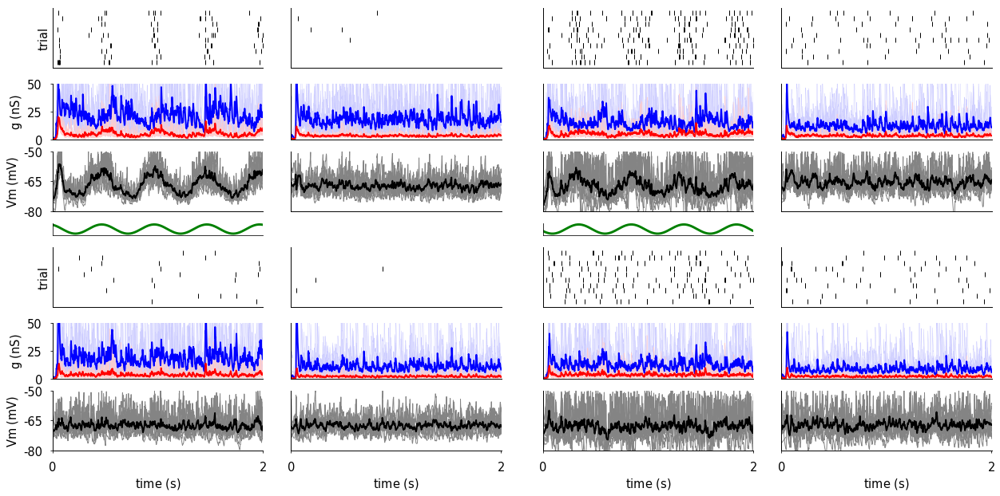

In [4]:
import lsv1m_paper
from mozaik.visualization import simple_plot
from mozaik.visualization import plotting
reload(simple_plot)
reload(plotting)
reload(lsv1m_paper)

#9,2

lsv1m_paper.LSV1MReponseOverview(data_store,ParameterSet
({'l4_exc_neuron' : 34816, 'l4_inh_neuron' : l4_inh_or_many_analog[2],'l23_exc_neuron' : l23_exc_or_many_analog[1], 'l23_inh_neuron' : l23_inh_or_many_analog[0]}),
                                 fig_param={'dpi' : 70,'figsize': (18,9)},plot_file_name='SingleCellOverview.png').plot(
                                    {'*.x_ticks':[0,2.0], 
                                     "*.title" : None,
                                     '*.Vm_plot.y_lim' : (-80,-50),
                                     '*.Conductance_plot.y_lim' : (0,50),
                                     })

LSV1MReponseOverview plotting took: 15.9621798992seconds


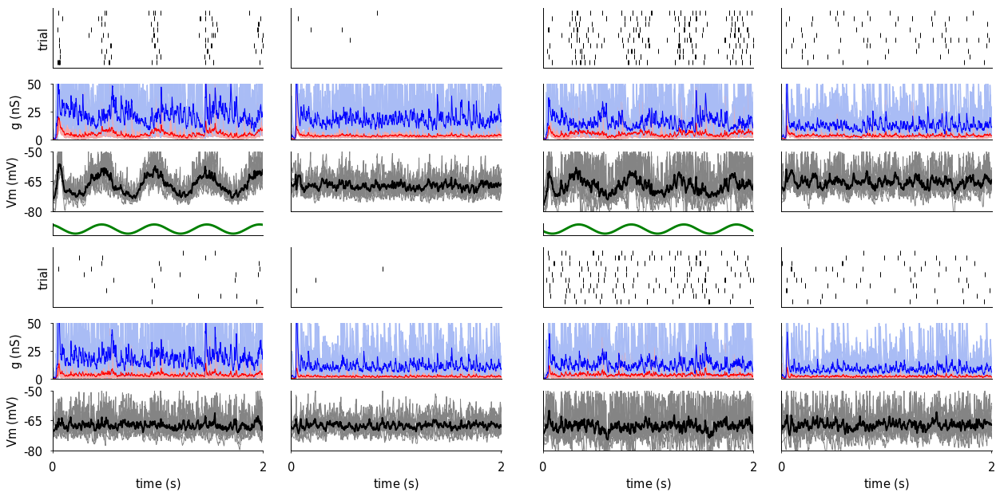

In [10]:
import lsv1m_paper
from mozaik.visualization import simple_plot
from mozaik.visualization import plotting
reload(simple_plot)
reload(plotting)
reload(lsv1m_paper)

#9,2

lsv1m_paper.LSV1MReponseOverview(data_store,ParameterSet
({'l4_exc_neuron' : 34816, 'l4_inh_neuron' : l4_inh_or_many_analog[2],'l23_exc_neuron' : l23_exc_or_many_analog[1], 'l23_inh_neuron' : l23_inh_or_many_analog[0]}),
                                 fig_param={'dpi' : 70,'figsize': (18,9)},plot_file_name='SingleCellOverview.png').plot(
                                    {'*.x_ticks':[0,2.0], 
                                     "*.title" : None,
                                     '*.Vm_plot.y_lim' : (-80,-50),
                                     '*.Conductance_plot.y_lim' : (0,50),
                                     })

OverviewPlot plotting took: 0.258905172348seconds


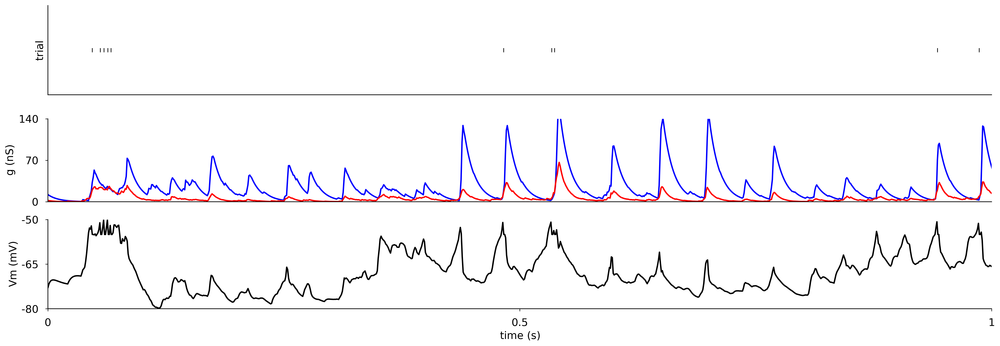

In [7]:
dsv = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,st_trial=0)    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : 34816 ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,140), 'Conductance_plot.low_pass' : False, '*.x_ticks' : None})


OverviewPlot plotting took: 0.221415996552seconds


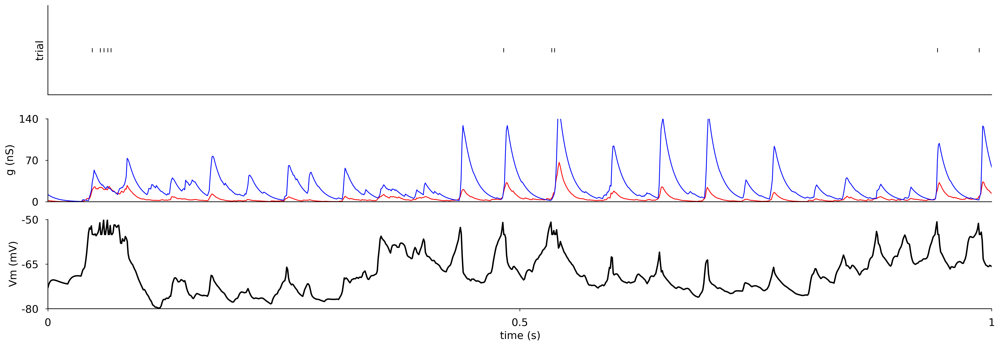

In [7]:
dsv = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,st_trial=0)    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : 34816 ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,140), '*.x_ticks' : None})


OverviewPlot plotting took: 0.261455059052seconds
OverviewPlot plotting took: 0.25768995285seconds
OverviewPlot plotting took: 0.276859045029seconds


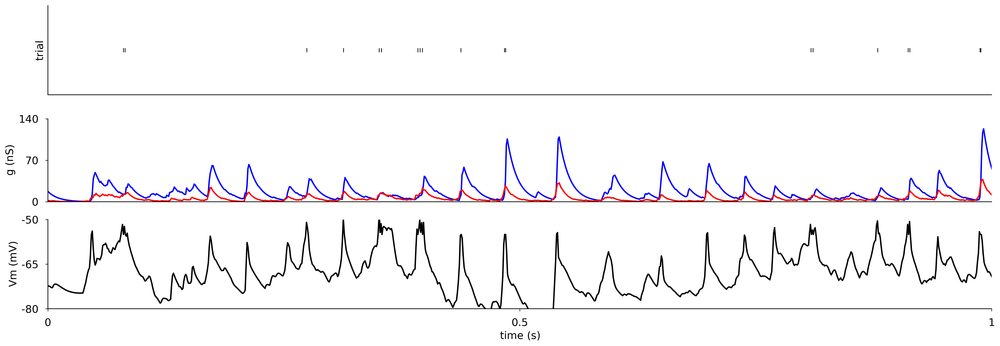

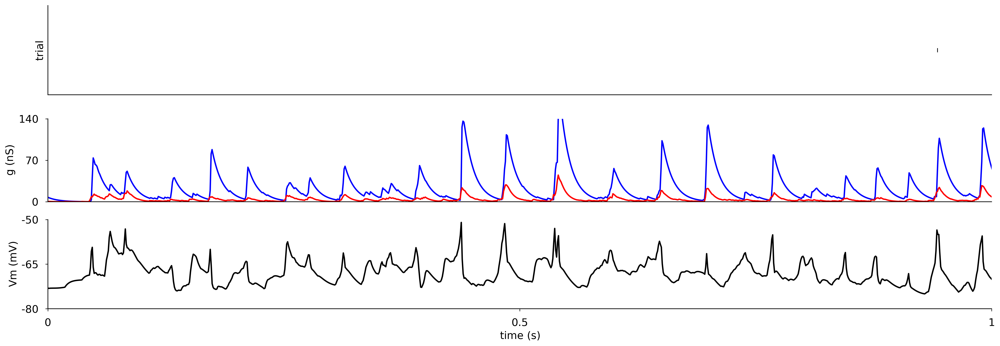

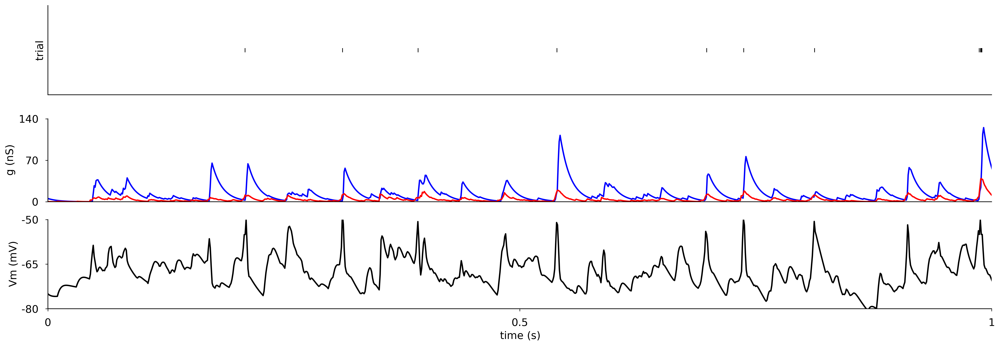

In [9]:
dsv = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,st_trial=0)    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Inh_L4', 'neuron' : l4_inh_or_many_analog[2] ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,140), 'Conductance_plot.low_pass' : False, '*.x_ticks' : None})
dsv = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,st_trial=0)    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L2/3', 'neuron' : l23_exc_or_many_analog[1] ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,140), 'Conductance_plot.low_pass' : False, '*.x_ticks' : None})
dsv = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,st_trial=0)    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Inh_L2/3', 'neuron' : l23_inh_or_many_analog[0] ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,140), 'Conductance_plot.low_pass' : False, '*.x_ticks' : None})


In [10]:
len(analog_ids)

40

In [11]:
dsv = queries.param_filter_query(data_store,sheet_name=['V1_Inh_L4'],st_contrast=[100],st_orientation=0)

e = []
i = []
for s in dsv.get_segments():
    for idd in l4_inh_or_many_analog:
        e.append(s.get_esyn(idd))
        i.append(s.get_isyn(idd))
print numpy.mean(e)
print numpy.mean(i)

L4Exc Mean HWHH: 23.6189922367
LC_HC diff:  0.763171074968  p= (array(2.4715574070307307), 0.014323435493109792)
L4Inh Mean HWHH: 32.3561842369
LC_HC diff:  1.76193412214  p= (array(4.510073753837793), 2.3521675677424063e-05)
L23Exc Mean HWHH: 23.2442316781
LC_HC diff:  1.15954347266  p= (array(2.1704893028632535), 0.033686665082277495)
L23Inh Mean HWHH: 31.2461232654
LC_HC diff:  0.951392034784  p= (array(1.4998284513733267), 0.13857601845795006)
HWHH Exc:  23.5245758169
HWHH Inh:  31.8444540018
L4Exc Mean RURA: 1.48577676877
L4Inh Mean RURA: 13.54915111
L23Exc Mean RURA: -2.83171541581
L23Inh Mean RURA: 14.450308693
Exc RURA: 0.410603617751
Inh RURA: 13.9645783646

NameError: name 'l4_inh_or_many_analog' is not defined

Removed \% of neurons: 0.0582120582121
Removed \% of neurons: 0.0575539568345
Removed \% of neurons: 0.120588235294
Removed \% of neurons: 0.0238095238095
Removed \% of neurons: 0.0561330561331
L4Exc Mean HWHH: (23.789691618454473, 0.21591392933151313)
LC_HC diff:  (0.8075605483210857, 0.2326475045288286)  p= (array(3.4673515015863785), 0.0005757794567128159)
Removed \% of neurons: 0.0431654676259
L4Inh Mean HWHH: (34.031879257217888, 0.78690103555116742)
LC_HC diff:  (1.5140188502065379, 0.54569483892051585)  p= (array(2.7639495919992676), 0.0065339527500156121)
Removed \% of neurons: 0.111764705882
L23Exc Mean HWHH: (24.580823013814765, 0.30467492900439475)
LC_HC diff:  (0.14791115479587316, 0.38804126392736082)  p= (array(0.3805421728270175), 0.70381140930561248)
Removed \% of neurons: 0.015873015873
L23Inh Mean HWHH: (32.420349943421549, 0.7433462430574298)
LC_HC diff:  (0.83747139693301087, 0.60303490368395585)  p= (array(1.383149889308039), 0.16912446761465388)
HWHH Exc:  (24.105

/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/mozaik/visualization/simple_plot.py:891: MatplotlibDeprecationWarning: pyplot.hold is deprecated.
    Future behavior will be consistent with the long-time default:
    plot commands add elements without first clearing the
    Axes and/or Figure.
  pylab.hold('on')
OrientationTuningSummaryFiringRates plotting took: 124.892473221seconds


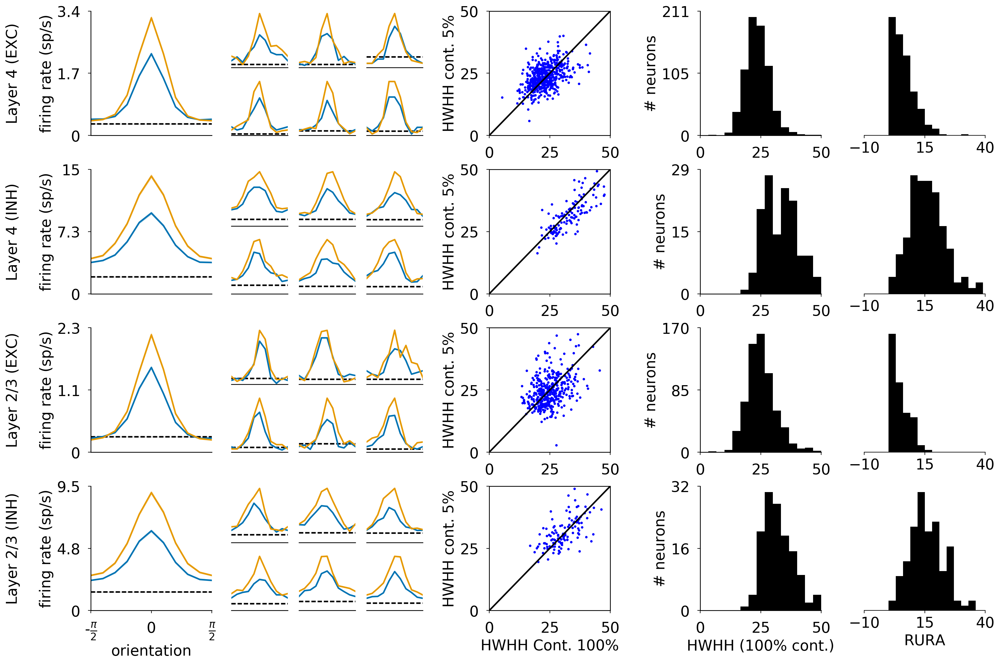

In [4]:
sys.path.insert(0,'/home/antolikjan/projects/mozaikold/contrib')
import lsv1m_paper
reload(lsv1m_paper)

lsv1m_paper.OrientationTuningSummaryFiringRates(data_store,ParameterSet({'exc_sheet_name1': 'V1_Exc_L4','inh_sheet_name1': 'V1_Inh_L4','exc_sheet_name2': 'V1_Exc_L2/3','inh_sheet_name2': 'V1_Inh_L2/3'}),fig_param={'dpi' : 200,'figsize': (18,12)},plot_file_name='OrientationTuningSummary.png').plot({'*.HistogramPlot.num_bins' : int(15),'*.fontsize' : 19, '*.HistogramPlot.colors' : '#000000'})            

Removed \% of neurons: 0.0582120582121
Removed \% of neurons: 0.0575539568345
Removed \% of neurons: 0.120588235294
Removed \% of neurons: 0.0238095238095
Removed \% of neurons: 0.0561330561331
L4Exc Mean HWHH: (23.789710661455498, 0.21591045020494201)
LC_HC diff:  (0.80757959374749111, 0.23264543468796217)  p= (array(3.467464124924871), 0.00057554452490321485)
Removed \% of neurons: 0.0431654676259
L4Inh Mean HWHH: (34.031878924604804, 0.78690087182556767)
LC_HC diff:  (1.5140182579485604, 0.54569477740747985)  p= (array(2.763948822354042), 0.0065339672973686192)
Removed \% of neurons: 0.111764705882
L23Exc Mean HWHH: (24.580823065450396, 0.30467493605844109)
LC_HC diff:  (0.14791122411071742, 0.38804125578858512)  p= (array(0.3805423591400337), 0.70381127117814501)
Removed \% of neurons: 0.015873015873
L23Inh Mean HWHH: (32.42034977902356, 0.74334612171403203)
LC_HC diff:  (0.83747123597350093, 0.6030348223561528)  p= (array(1.383149810008101), 0.16912449186685699)
HWHH Exc:  (24.105

/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/matplotlib/__init__.py:918: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))
/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/matplotlib/__init__.py:895: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))
OrientationTuningSummaryFiringRates plotting took: 190.225350857seconds
OrientationTuningSummaryFiringRates plotting took: 190.225350857seconds


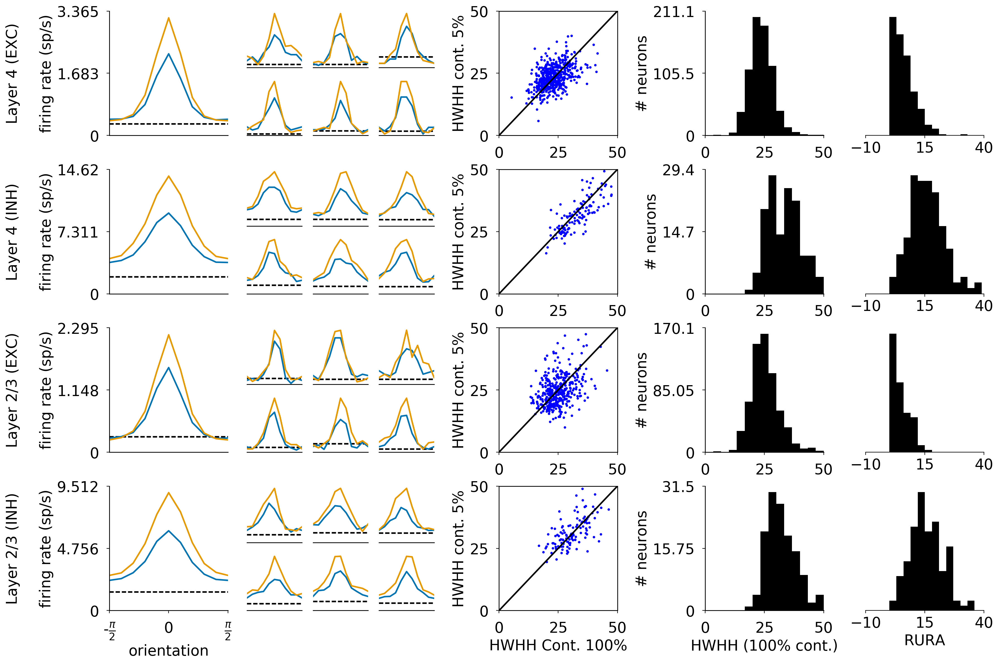

In [4]:
sys.path.insert(0,'/home/antolikjan/projects/mozaikold/contrib')
import lsv1m_paper
reload(lsv1m_paper)
lsv1m_paper.OrientationTuningSummaryFiringRates(data_store,ParameterSet({'exc_sheet_name1': 'V1_Exc_L4','inh_sheet_name1': 'V1_Inh_L4','exc_sheet_name2': 'V1_Exc_L2/3','inh_sheet_name2': 'V1_Inh_L2/3'}),fig_param={'dpi' : 200,'figsize': (18,12)},plot_file_name='OrientationTuningSummary.png').plot({'*.HistogramPlot.num_bins' : int(15),'*.fontsize' : 19})            

In [ ]:
Removed \% of neurons: 0.0582120582121
Removed \% of neurons: 0.0575539568345
Removed \% of neurons: 0.120588235294
Removed \% of neurons: 0.0238095238095

In [6]:
#TrialAveragedFiringRate(param_filter_query(data_store,st_direct_stimulation_name="None",st_name='InternalStimulus'),ParameterSet({})).analyse()
param_filter_query(data_store,analysis_algorithm='TrialAveragedFiringRate',sheet_name="V1_Exc_L4",st_name='InternalStimulus').print_content(full_ADS=True)

INFO:Mozaik:DSV info:
  DSV info:
INFO:Mozaik:   Number of recordings: 0
     Number of recordings: 0
INFO:Mozaik:   Number of ADS: 1
     Number of ADS: 1
INFO:Mozaik:     PerNeuronValue : 1
       PerNeuronValue : 1
INFO:Mozaik:ANALYSIS RESULTS
  ANALYSIS RESULTS
INFO:Mozaik:{"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320, "frame_duration":40320, "name":\'InternalStimulus\', "trial":None}', "value_name":'Firing rate'}
  {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'TrialAveragedFiringRate', "identifier":'PerNeuronValue', "name":'PerNeuronValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":40320,

In [179]:
import mozaik.analysis.vision
reload(mozaik.analysis.vision)
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name=['V1_Exc_L2/3','V1_Exc_L4','V1_Inh_L2/3','V1_Inh_L4'])
mozaik.analysis.vision.Analog_F0andF1(dsv,ParameterSet({})).analyse()


  Starting Analog_F0andF1 analysis


Analog_F0andF1 analysis took: 202.370101929seconds


/home/antolikjan/projects/mozaikold/contrib/lsv1m_paper.pyc
40 67


INFO:Mozaik:49
  49
INFO:Mozaik:684
  684


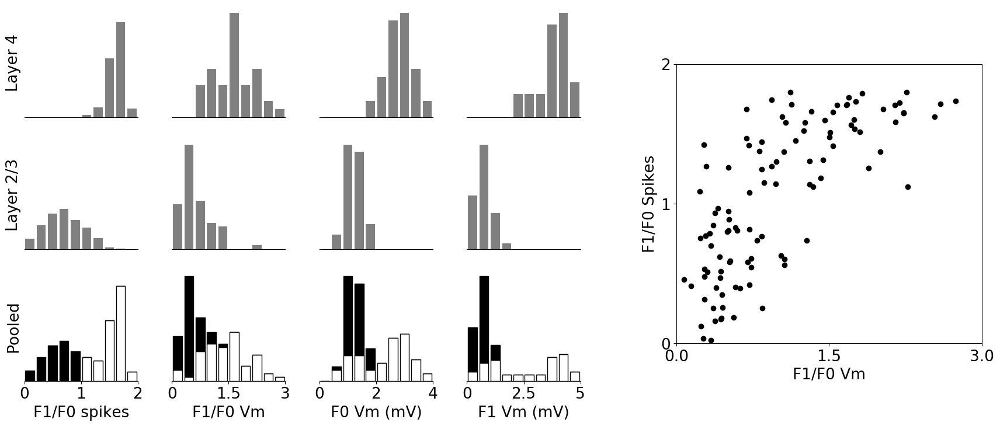

In [3]:
sys.path.insert(0,'/home/antolikjan/projects/mozaikold/contrib')
import lsv1m_paper
reload(lsv1m_paper)
print lsv1m_paper.__file__
lsv1m_paper.MRfigReal(param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Exc_L4','V1_Inh_L2/3','V1_Inh_L4'],st_contrast=[100],st_name='FullfieldDriftingSinusoidalGrating'),ParameterSet({'SimpleSheetName' : 'V1_Exc_L4','ComplexSheetName' : 'V1_Exc_L2/3'}),plot_file_name='MR.png',fig_param={'dpi' : 100,'figsize': (19,8)}).plot()

40 67


INFO:Mozaik:54
  54
INFO:Mozaik:694
  694


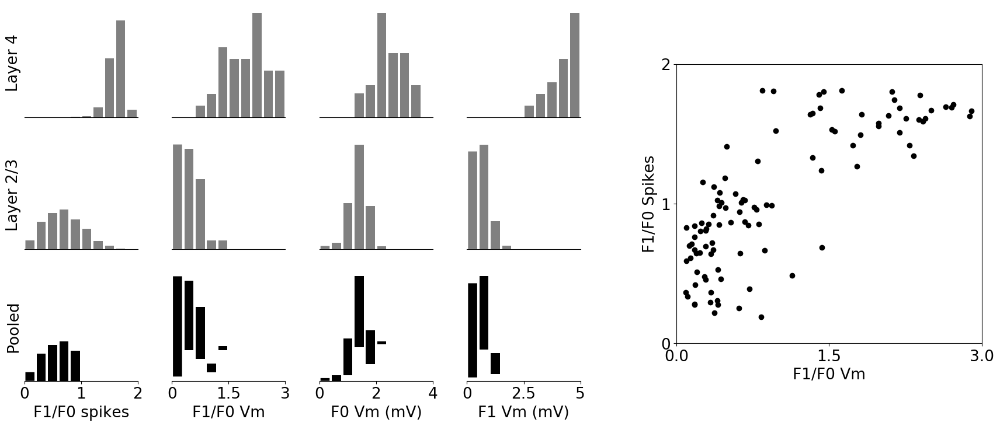

In [2]:
#sys.path.insert(0,'/home/antolikjan/projects/mozaikold/contrib')
#import lsv1m_paper
#reload(lsv1m_paper)
#print lsv1m_paper.__file__
lsv1m_paper.MRfigReal(param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Exc_L4','V1_Inh_L2/3','V1_Inh_L4'],st_contrast=[100],st_name='FullfieldDriftingSinusoidalGrating'),ParameterSet({'SimpleSheetName' : 'V1_Exc_L4','ComplexSheetName' : 'V1_Exc_L2/3'}),plot_file_name='MR.png',fig_param={'dpi' : 100,'figsize': (19,8)}).plot()

INFO:Mozaik:Starting ModulationRatio analysis
  Starting ModulationRatio analysis
INFO:Mozaik:DSV info:
  DSV info:
INFO:Mozaik:   Number of recordings: 400
     Number of recordings: 400


V1_Exc_L2/3


INFO:Mozaik:     FullfieldDriftingSinusoidalGrating : 400
       FullfieldDriftingSinusoidalGrating : 400
INFO:Mozaik:   Number of ADS: 1396
     Number of ADS: 1396
INFO:Mozaik:     AnalogSignalList : 580
       AnalogSignalList : 580
INFO:Mozaik:     PerNeuronValue : 816
       PerNeuronValue : 816
INFO:Mozaik:DSV info:
  DSV info:
INFO:Mozaik:   Number of recordings: 0
     Number of recordings: 0
INFO:Mozaik:   Number of ADS: 100
     Number of ADS: 100
INFO:Mozaik:     AnalogSignalList : 100
       AnalogSignalList : 100


[0.0, 2.5132741228718345, 0.9424777960769379, 1.8849555921538759, 1.5707963267948966, 2.827433388230814, 0.3141592653589793, 0.6283185307179586, 1.2566370614359172, 2.199114857512855]


INFO:Mozaik:DSV info:
  DSV info:
INFO:Mozaik:   Number of recordings: 400
     Number of recordings: 400


V1_Exc_L4


INFO:Mozaik:     FullfieldDriftingSinusoidalGrating : 400
       FullfieldDriftingSinusoidalGrating : 400
INFO:Mozaik:   Number of ADS: 1396
     Number of ADS: 1396
INFO:Mozaik:     AnalogSignalList : 580
       AnalogSignalList : 580
INFO:Mozaik:     PerNeuronValue : 816
       PerNeuronValue : 816
INFO:Mozaik:DSV info:
  DSV info:
INFO:Mozaik:   Number of recordings: 0
     Number of recordings: 0
INFO:Mozaik:   Number of ADS: 100
     Number of ADS: 100
INFO:Mozaik:     AnalogSignalList : 100
       AnalogSignalList : 100


[0.0, 0.9424777960769379, 1.8849555921538759, 1.5707963267948966, 2.827433388230814, 0.6283185307179586, 2.5132741228718345, 0.3141592653589793, 1.2566370614359172, 2.199114857512855]


ModulationRatio analysis took: 36.1794068813seconds


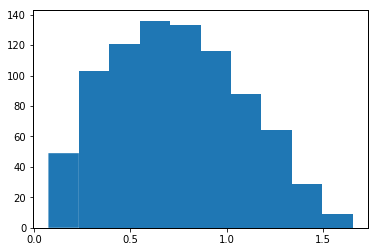

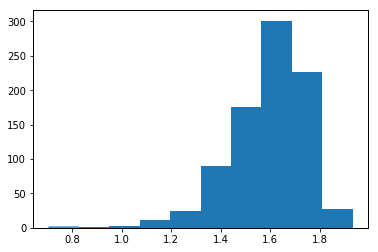

In [5]:
ModulationRatio(param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Exc_L4'],st_contrast=[10]),ParameterSet({})).analyse()

In [76]:
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',st_contrast=100,st_orientation=0)
Analog_MeanSTDAndFanoFactor(dsv,ParameterSet({})).analyse()


  Starting Analog_MeanSTDAndFanoFactor analysis
  Starting Analog_MeanSTDAndFanoFactor analysis
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:1096: RuntimeWarning: invalid value encountered in double_scalars
  esyn_fano_factor = numpy.array([std**2/abs(mean) for (std,mean) in zip(esyn_std,esyn_mean)])
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:1097: RuntimeWarning: invalid value encountered in double_scalars
  isyn_fano_factor = numpy.array([std**2/abs(mean) for (std,mean) in zip(isyn_std,isyn_mean)])
Analog_MeanSTDAndFanoFactor analysis took: 49.3447329998seconds
Analog_MeanSTDAndFanoFactor analysis took: 49.3447329998seconds


[-66.834240020282067, -68.38671072720912, -66.317178650467554, -67.742933308780167, -65.210205992071124, -68.306766703354228, -62.373557359162447, -65.403599061704043, -67.952478712786203, -68.241085951507273, -62.262927532481896, -62.435691111571167, -64.219579171666609, -67.927208363371165, -66.671331260654995, -69.584018335419117, -65.786954869688245, -67.801040252861981, -66.675403691530249, -66.581131071594356, -64.913781369592044, -67.969361952640966, -62.818790093323138, -62.425360622108037, -62.428513681040457, -64.314423836083108, -66.371610974790357, -63.49850197333231, -67.314239876166226, -66.997899198905301]


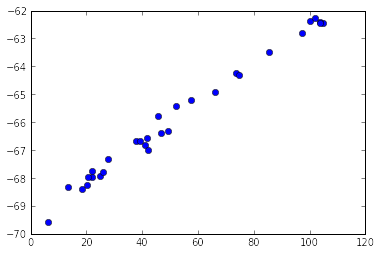

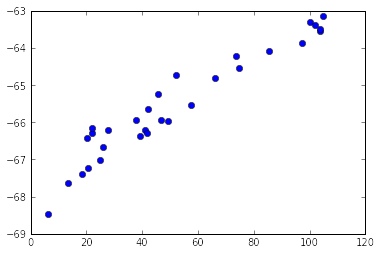

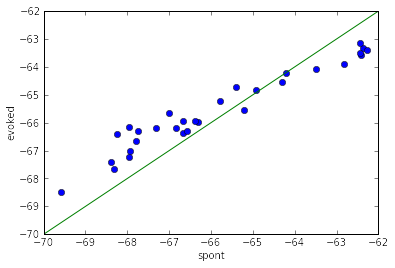

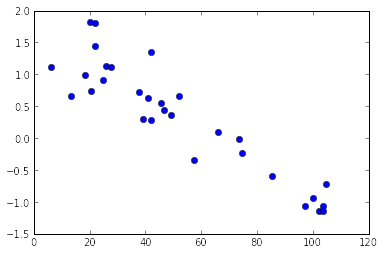

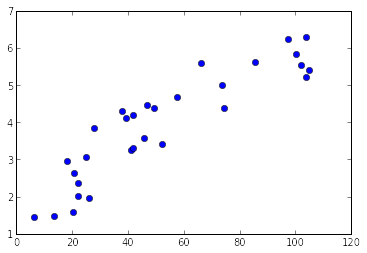

In [8]:
#sids = [38752, 34305, 22338, 33699, 37539, 21638, 36230, 38374, 16871, 17735, 18088, 29576, 33224, 38732, 22030, 23630, 36686, 23951, 39119, 23377, 17010, 19955, 39092, 19765, 32342, 28633, 33017, 21210, 29915, 17790, 26910, 37983]
sids = list(analog_center4)
a = param_filter_query(data_store,st_name=['InternalStimulus'],value_name='Mean(VM)',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(sids)
b = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,value_name='F0_Vm',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(sids)
c = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,value_name='-(x+y)(F0_Vm,Mean(VM))',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(sids)
d = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,value_name='F1_Vm',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(sids)
e = data_store.full_datastore.get_analysis_result(identifier='PerNeuronValue',value_name = 'aff_samples', sheet_name = 'V1_Exc_L4')[0].get_value_by_id(sids)
pylab.figure()
pylab.plot(e,a,'o')
pylab.figure()
pylab.plot(e,-numpy.array(b),'o')
pylab.figure()
pylab.plot(a,-numpy.array(b),'o')
pylab.plot([-70,-62],[-70,-62])
pylab.xlabel('spont')
pylab.ylabel('evoked')
pylab.figure()
pylab.plot(e,c,'o')
pylab.figure()
pylab.plot(e,d,'o')

print a



In [59]:
print a[0]
print b[0]
print numpy.mean(a+b)

-68.0408720866
69.1102580943
0.269927230212


(0, 2000)

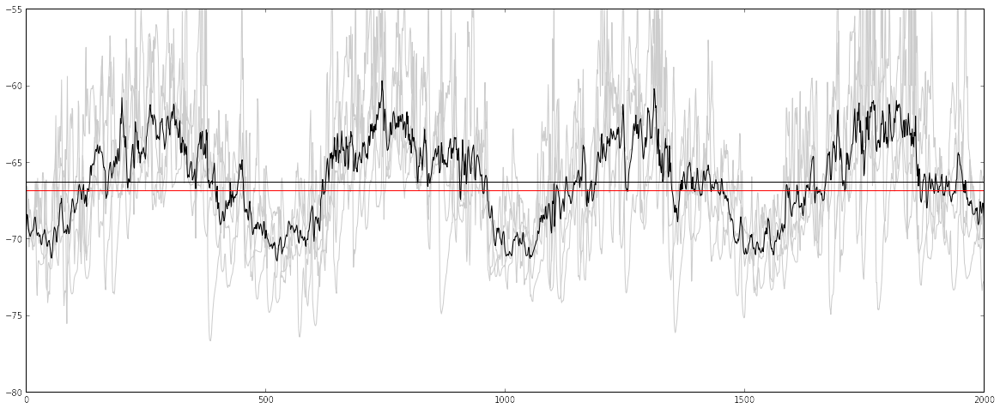

In [11]:
segs = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,sheet_name='V1_Exc_L4').get_segments()

vm = [s.get_vm(sids[0]) for s in segs]

vm = numpy.array(vm)[:,250:]

spont = param_filter_query(data_store,st_name=['InternalStimulus'],sheet_name='V1_Exc_L4').get_segments()[0].get_vm(sids[0])


pylab.figure(figsize=(20,8))
pylab.plot(vm[0],c='0.8')
pylab.plot(vm[1],c='0.8')
pylab.plot(vm[2],c='0.8')
pylab.plot(vm[3],c='0.8')
pylab.plot(numpy.mean(vm,axis=0),c='0.0')
#pylab.plot(spont,'r')

pylab.plot([0,2000],[numpy.mean(vm),numpy.mean(vm)],'k')
pylab.plot([0,2000],[numpy.mean(spont),numpy.mean(spont)],'r')

pylab.ylim(-80,-55)
pylab.xlim([0,2000])

In [ ]:
pylab.figure()
pylab.plot(a,c,'o')
pylab.figure()
pylab.plot(b,c,'o')


In [6]:
print(analog_ids[2])
print a[2]
print b[2]
print c[2]
print d[2]
print e[2]

print a

22338
-61.1225027641
61.4763303468
-0.353827582652
5.85728404049
[ 102.10596943]
[-62.078378088456184, -66.516297224541532, -61.122502764122586, -62.350692467344466, -66.237729774454507, -65.410604036609641, -68.467236278298671, -61.974189681828229, -64.419861037875762, -62.048232623834345, -68.355658955997001, -65.787265748518692, -64.17023654915053, -67.383610778214361, -68.174690637278573, -66.933684226237517, -68.043235094566924, -65.097254940376502, -67.56814543084451, -69.846528378154261, -65.753766054449116, -63.418699810185061, -63.317037321160875, -67.917322813535137, -66.527050462502729, -66.431063243548579, -67.838599936687729, -64.671345807380348, -67.956223413541224, -66.685302498723189, -68.955677001296536, -61.825378619501933]


In [24]:
print e[19]

[ 6.25429014]


  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
OverviewPlot plotting took: 0.844115018845seconds
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_

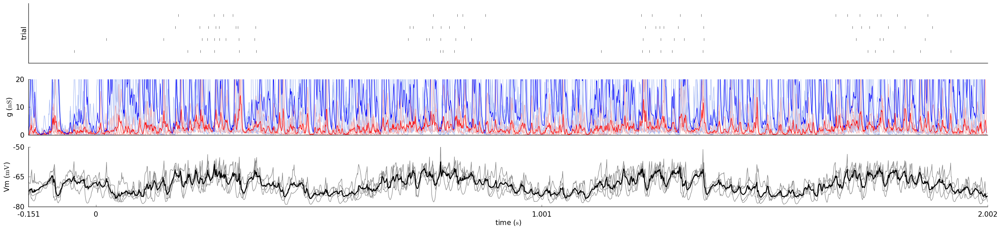

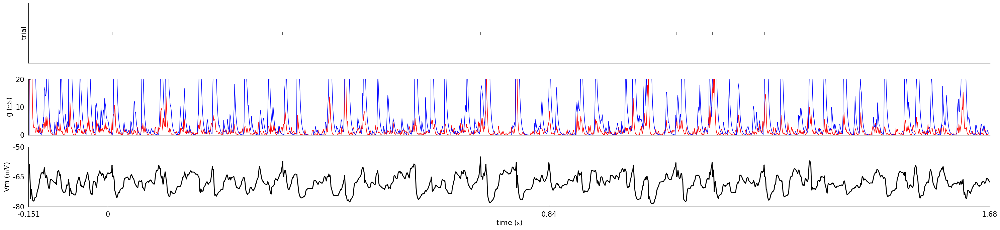

In [11]:
dsv = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0)    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : sids[0] ,'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (30,7)},plot_file_name='Overview_ExcL4_1.png').plot({'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,20)})
dsv = param_filter_query(data_store,st_name=['InternalStimulus'])    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : sids[0] ,'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (30,7)},plot_file_name='Overview_ExcL4_1.png').plot({'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,20)})


0.930872583747
948
0.930872583747
948
0.930872583747


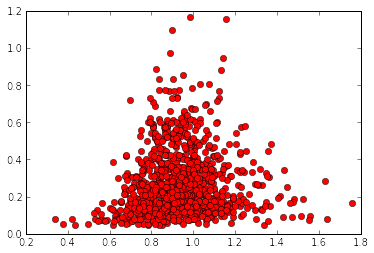

In [10]:
dsv1 = queries.param_filter_query(data_store,value_name='CV of ISI squared',st_name='InternalStimulus',sheet_name='V1_Exc_L4')
a= dsv1.get_analysis_result()[0].values
print numpy.mean(a)
ids = dsv1.get_analysis_result()[0].ids
dsv = queries.param_filter_query(data_store,value_name='Firing rate',st_name='InternalStimulus',sheet_name='V1_Exc_L4')
b=numpy.array(dsv.get_analysis_result()[0].get_value_by_id(ids))
print len(ids)
print numpy.mean(dsv1.get_analysis_result()[0].get_value_by_id(ids))
ids = numpy.array(ids)[b>0.0]
print len(ids)



print numpy.mean(dsv1.get_analysis_result()[0].get_value_by_id(ids))

pylab.plot(a,b,'ro')

In [26]:
ads = queries.param_filter_query(data_store,st_direct_stimulation_name="None",st_name='InternalStimulus',sheet_name='V1_Exc_L4',value_name='Correlation coefficient(psth (bin=10.0))',ads_unique=True).get_analysis_result()[0]
b = numpy.array(queries.param_filter_query(data_store,value_name='Firing rate',st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(ads.ids))

print numpy.shape(ads.values)
numpy.mean(ads.get_value_by_ids(ids,ids))



(961, 961)


IndexError: index 948 is out of bounds for axis 0 with size 948

In [27]:
ads = queries.param_filter_query(data_store,value_name='CV of ISI squared',st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_analysis_result()[0]
b = numpy.array(queries.param_filter_query(data_store,value_name='Firing rate',st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(ads.ids))
numpy.mean(ads.get_value_by_id(numpy.array(ads.ids)[b>0.2]))

s = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_segments()[0]


0.94405615932212539

In [17]:
mean_and_std = lambda x : (numpy.mean(x),numpy.std(x))

s = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_segments()[0]
isis = [numpy.diff(st.magnitude) for st in s.spiketrains]
idxs = numpy.array([len(isi) for isi in isis])>20
mean_CV_L4E,std_CV_L4E = mean_and_std(numpy.array([numpy.std(isi)/numpy.mean(isi) for isi in isis])[idxs])
s = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4',value_name='Correlation coefficient(psth (bin=10.0))',ads_unique=True).get_analysis_result()[0]
mean_CC_L4E,std_CC_L4E = mean_and_std(numpy.array(s.values)[idxs,:][:,idxs][numpy.triu_indices(sum(idxs==True),1)])

In [ ]:
s = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4',value_name='Correlation coefficient(psth (bin=10.0))',ads_unique=True).get_analysis_result()[0]
idxs = numpy.array([len(isi) for isi in isis])>20

print numpy.mean(numpy.array(s.values)[idxs,:][:,idxs][numpy.triu_indices(sum(idxs==True),1)])

In [ ]:
PSTH(param_filter_query(data_store),ParameterSet({'bin_length' : 2.0 })).analyse()

  Starting PSTH analysis


In [ ]:
NeuronToNeuronAnalogSignalCorrelations(param_filter_query(data_store,analysis_algorithm='PSTH',value_name='psth (bin=10.0)'),ParameterSet({'convert_nan_to_zero' : True})).analyse()

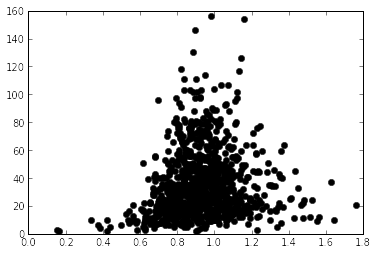

In [83]:
pylab.plot(cv_isi,[len(isi) for isi in isis],'ko')

In [69]:
print numpy.argmin([len(st.magnitude) for st in s.spiketrains])

11


In [70]:
print s.spiketrains[11]

[  2068.5   6688.1  95568.2] ms


In [73]:
print numpy.diff([  2068.5   ,6688.1,  95568.2])

[  4619.6  88880.1]


In [76]:
numpy.std([  4619.6,  88880.1])

42130.250000000007

In [38]:
numpy.var([10,20])

25.0

In [90]:
seg = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L2/3').get_segments()[0]

In [48]:
#sys.path.insert(0,'/home/antolikjan/projects/mozaik/mozaik/analysis')
from mozaik.analysis import analysis
from mozaik.storage import neo_neurotools_wrapper
reload(neo_neurotools_wrapper)
#print analysis.__file__
reload(analysis)
analysis.Irregularity(param_filter_query(data_store,st_direct_stimulation_name="None",st_name='InternalStimulus'),ParameterSet({})).analyse()

  Starting Irregularity analysis
Irregularity analysis took: 0.497019052505seconds


In [19]:
PopulationMeanAndVar(param_filter_query(data_store,analysis_algorithm='Irregularity',st_direct_stimulation_name="None",st_name='InternalStimulus'),ParameterSet({})).analyse()

  Starting PopulationMeanAndVar analysis
PopulationMeanAndVar analysis took: 4.68092989922seconds


In [ ]:
dsv = queries.param_filter_query(data_store,value_name=['F1_Vm'],st_name='FullfieldDriftingSinusoidalGrating')

539


INFO:Mozaik:mean_firing_rate_L4E :0.304343927606
  mean_firing_rate_L4E :0.304343927606
INFO:Mozaik:mean_firing_rate_L4I :1.97312127976
  mean_firing_rate_L4I :1.97312127976
INFO:Mozaik:mean_firing_rate_L23E :0.272203270066
  mean_firing_rate_L23E :0.272203270066
INFO:Mozaik:mean_firing_rate_L23I :1.39939511684
  mean_firing_rate_L23I :1.39939511684
INFO:Mozaik:mean_CV_L4E :0.890640018818
  mean_CV_L4E :0.890640018818
INFO:Mozaik:mean_CV_L4I :0.889880640576
  mean_CV_L4I :0.889880640576
INFO:Mozaik:mean_CV_L23E :0.870350874486
  mean_CV_L23E :0.870350874486
INFO:Mozaik:mean_CV_L23I :0.812181069161
  mean_CV_L23I :0.812181069161
INFO:Mozaik:mean_CC_L4E :0.00288569593398
  mean_CC_L4E :0.00288569593398
INFO:Mozaik:mean_CC_L4I :0.0418608193934
  mean_CC_L4I :0.0418608193934
INFO:Mozaik:mean_CC_L23E :0.00398550638256
  mean_CC_L23E :0.00398550638256
INFO:Mozaik:mean_CC_L23I :0.0319803866563
  mean_CC_L23I :0.0319803866563
INFO:Mozaik:mean_VM_L4E :-69.2520758804
  mean_VM_L4E :-69.252075880

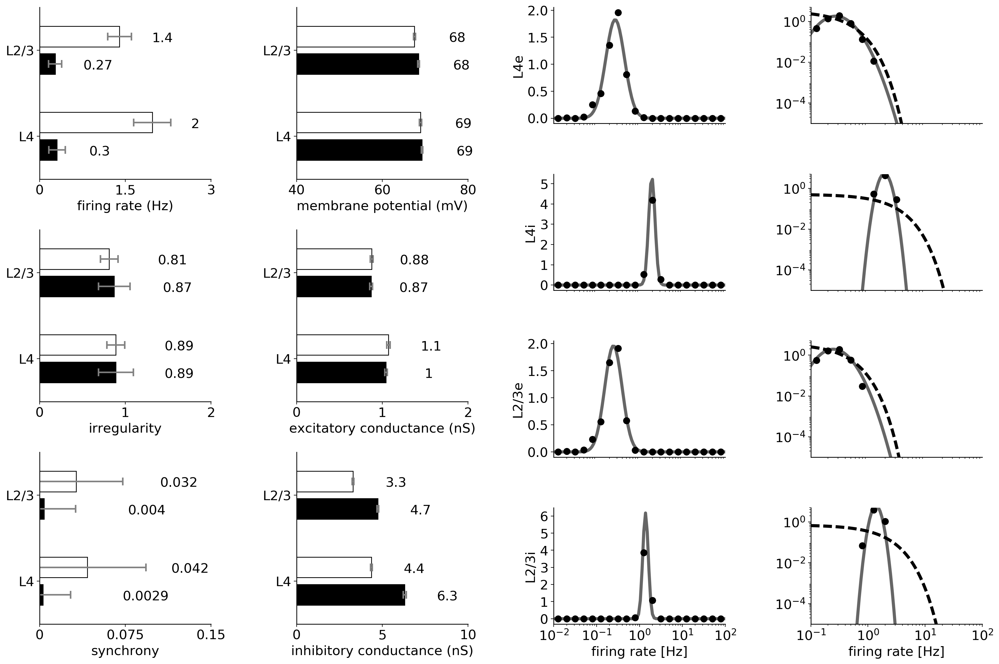

In [5]:
sys.path.insert(0,'/home/antolikjan/projects/mozaikold/contrib')
import lsv1m_paper
reload(lsv1m_paper)
lsv1m_paper.SpontStatisticsOverview(data_store,ParameterSet({}),plot_file_name='SpontStatActOverview.png', fig_param={'dpi' : 200,'figsize': (18,12)}).plot()

539


INFO:Mozaik:mean_firing_rate_L4E :0.304343927606
  mean_firing_rate_L4E :0.304343927606
INFO:Mozaik:mean_firing_rate_L4I :1.97312127976
  mean_firing_rate_L4I :1.97312127976
INFO:Mozaik:mean_firing_rate_L23E :0.272203270066
  mean_firing_rate_L23E :0.272203270066
INFO:Mozaik:mean_firing_rate_L23I :1.39939511684
  mean_firing_rate_L23I :1.39939511684
/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/numpy/core/_methods.py:89: RuntimeWarning: invalid value encountered in true_divide
  arrmean, rcount, out=arrmean, casting='unsafe', subok=False)
/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/numpy/core/_methods.py:111: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/antolikjan/virt_env/mozaikold/local/lib/python2.7/site-packages/numpy/core/_methods.py:55: RuntimeWarning: Mean of empty slice.
  warnings.warn("Mean of empty slice.", RuntimeWarning)
/home/antolikjan/virt_env/mozaikold/local/lib/

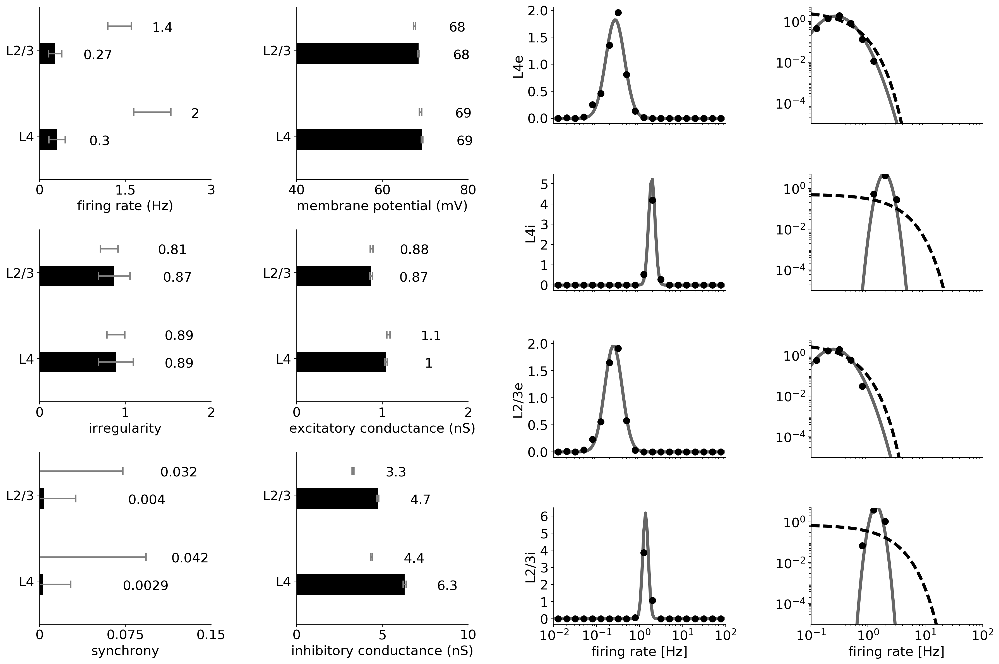

In [7]:
sys.path.insert(0,'/home/antolikjan/projects/mozaikold/contrib')
import lsv1m_paper
reload(lsv1m_paper)
lsv1m_paper.SpontStatisticsOverview(data_store,ParameterSet({}),plot_file_name='SpontStatActOverview.png', fig_param={'dpi' : 200,'figsize': (18,12)}).plot()

OrientationTuningSummaryAnalogSignals plotting took: 114.615957022seconds


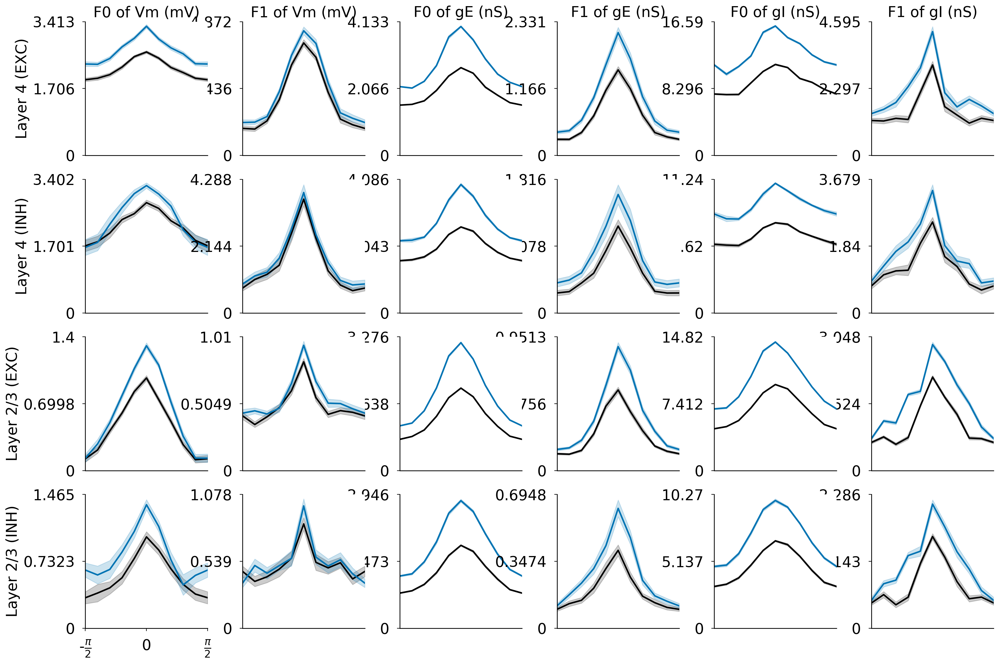

In [6]:
reload(lsv1m_paper)
lsv1m_paper.OrientationTuningSummaryAnalogSignals(data_store,ParameterSet({'exc_sheet_name1': 'V1_Exc_L4','inh_sheet_name1': 'V1_Inh_L4','exc_sheet_name2': 'V1_Exc_L2/3','inh_sheet_name2': 'V1_Inh_L2/3'}),fig_param={'dpi' : 200,'figsize': (18,12)},plot_file_name='OrientationTuningSummaryAnalogSignals.png').plot({'*.y_lim' : (0,None),'*.fontsize' : 19})            

OrientationTuningSummaryAnalogSignals plotting took: 174.653949976seconds


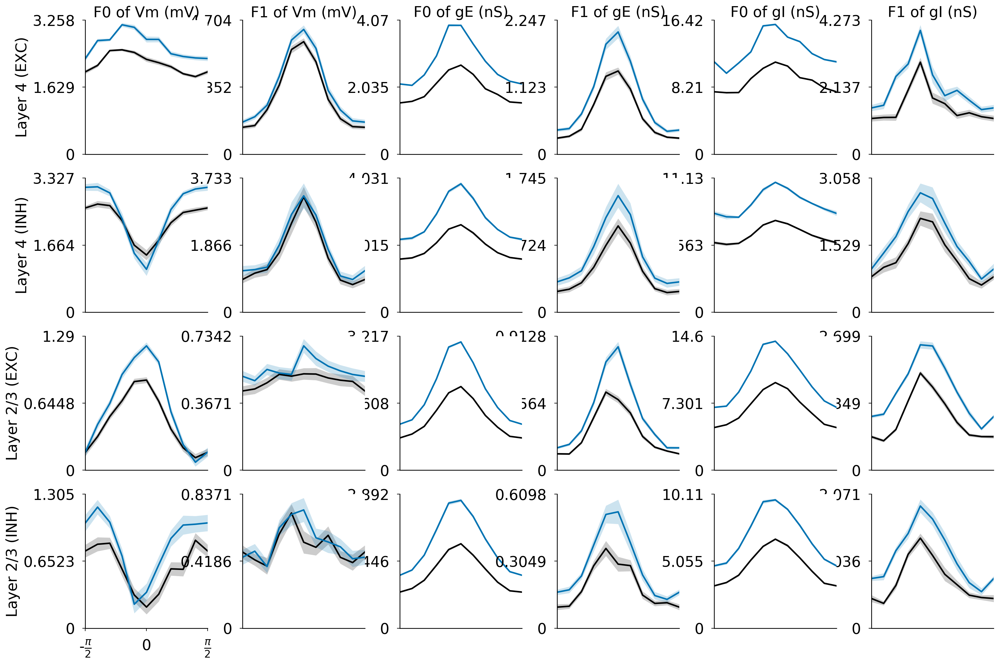

In [5]:
reload(lsv1m_paper)
lsv1m_paper.OrientationTuningSummaryAnalogSignals(data_store,ParameterSet({'exc_sheet_name1': 'V1_Exc_L4','inh_sheet_name1': 'V1_Inh_L4','exc_sheet_name2': 'V1_Exc_L2/3','inh_sheet_name2': 'V1_Inh_L2/3'}),fig_param={'dpi' : 200,'figsize': (18,12)},plot_file_name='OrientationTuningSummaryAnalogSignals.png').plot({'*.y_lim' : (0,None),'*.fontsize' : 19})            

SpontActOverview plotting took: 53.2447690964seconds


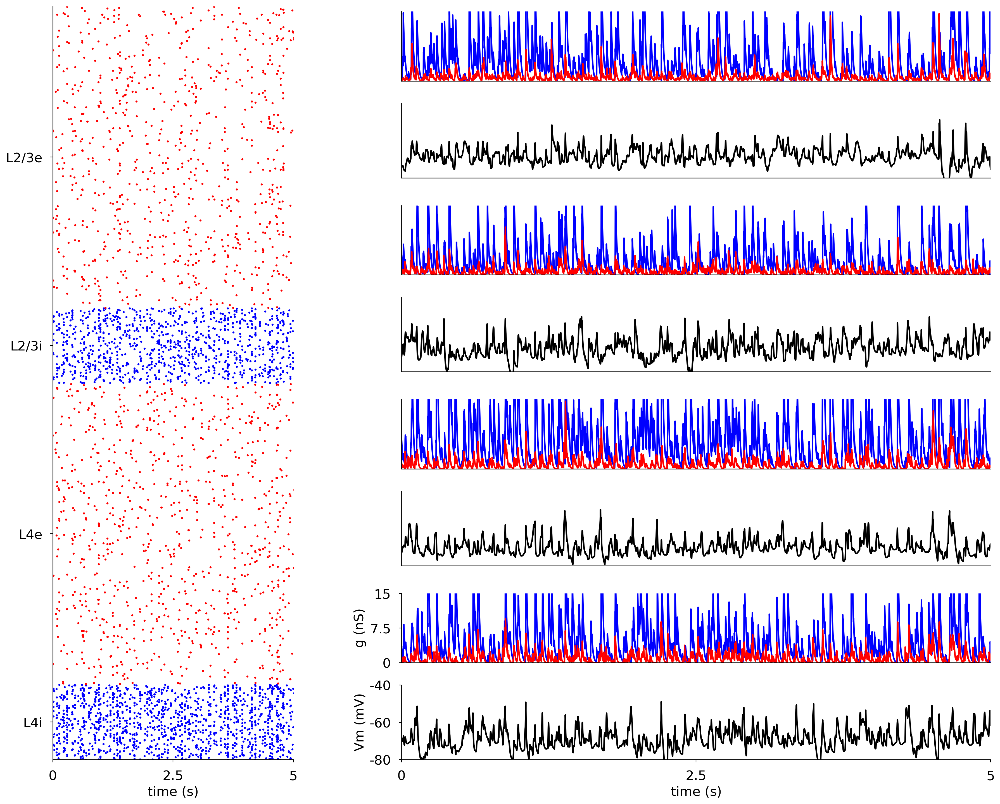

In [7]:
reload(lsv1m_paper)
lsv1m_paper.SpontActOverview(data_store,ParameterSet({'l4_exc_neuron' : analog_ids[0], 'l4_inh_neuron' : analog_ids_inh[0],'l23_exc_neuron' : analog_ids23[0],'l23_inh_neuron' : analog_ids_inh23[0]}),plot_file_name='SpontActOverview.png', fig_param={'dpi' : 200,'figsize': (18,14.5)}).plot()

OverviewPlot plotting took: 1.373046875seconds
OverviewPlot plotting took: 1.35316586494seconds
OverviewPlot plotting took: 4.49570512772seconds
OverviewPlot plotting took: 1.36725902557seconds


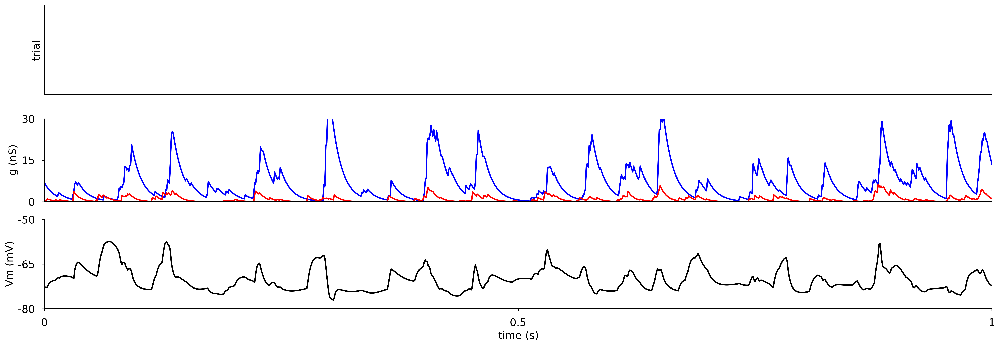

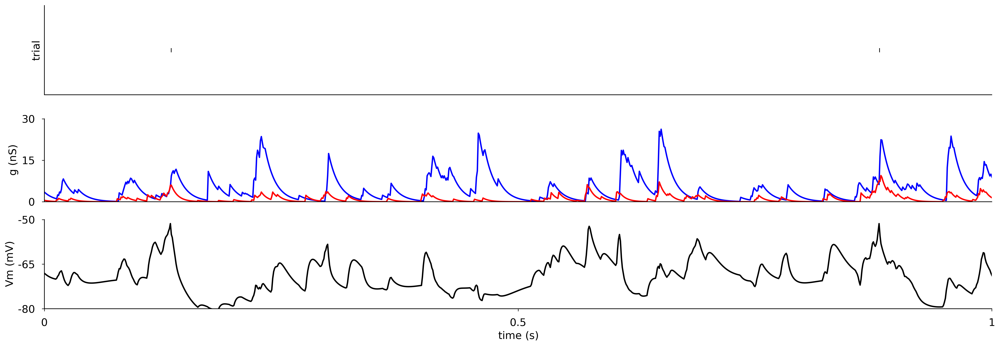

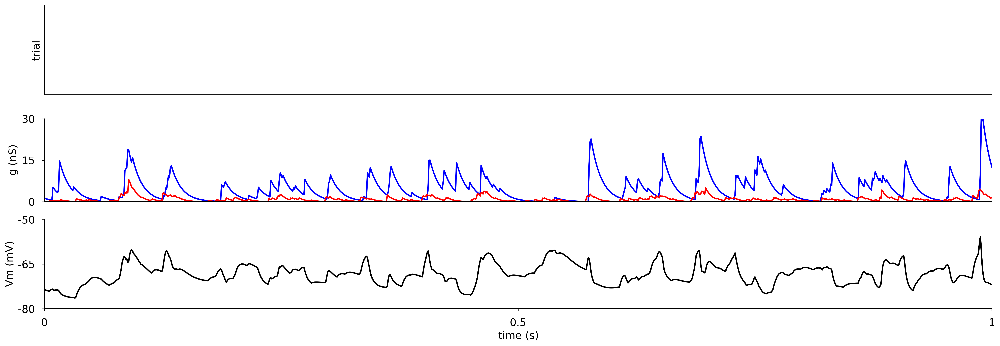

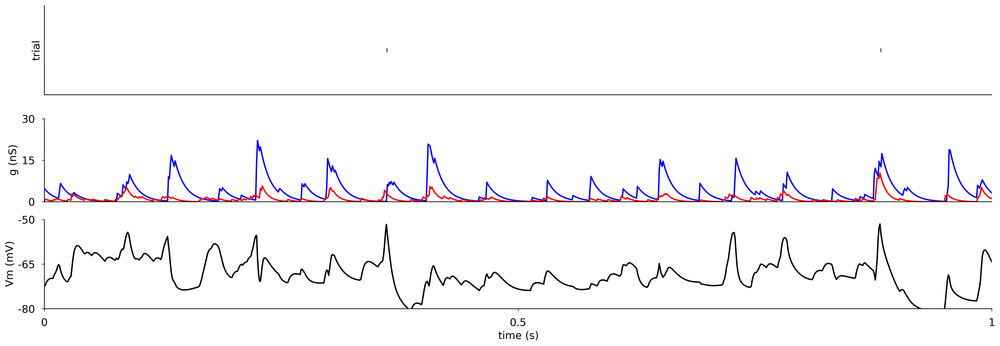

In [18]:
dsv=queries.param_filter_query(data_store,st_direct_stimulation_name='None',st_name="InternalStimulus")
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : analog_ids[0] ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,30), 'Conductance_plot.low_pass' : False,'*.x_ticks' : None})
dsv=queries.param_filter_query(data_store,st_direct_stimulation_name='None',st_name="InternalStimulus")
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Inh_L4', 'neuron' : analog_ids_inh[0] ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,30), 'Conductance_plot.low_pass' : False,'*.x_ticks' : None})
dsv=queries.param_filter_query(data_store,st_direct_stimulation_name='None',st_name="InternalStimulus")
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L2/3', 'neuron' : analog_ids23[0] ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,30), 'Conductance_plot.low_pass' : False,'*.x_ticks' : None})
dsv=queries.param_filter_query(data_store,st_direct_stimulation_name='None',st_name="InternalStimulus")
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Inh_L2/3', 'neuron' : analog_ids_inh23[0] ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,30), 'Conductance_plot.low_pass' : False,'*.x_ticks' : None})


In [13]:
queries.param_filter_query(data_store,st_direct_stimulation_name='None',st_name="InternalStimulus",sheet_name = 'V1_Exc_L4').get_segments()


AttributeError: 'PickledDataStoreNeoWrapper' object has no attribute 'analogsignalarrays'

ActivityMovie plotting took: 5.03408002853seconds


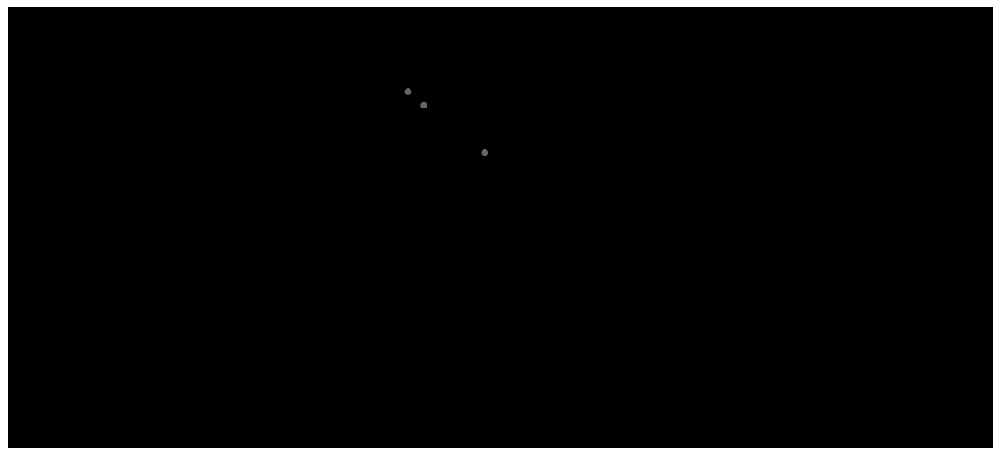

In [51]:
reload(mozaik.visualization.plotting)
dsv = param_filter_query(data_store,st_name=['InternalStimulus'])    
mozaik.visualization.plotting.ActivityMovie(dsv,ParameterSet({'bin_width': 10.0,'scatter':  True,'resolution': 10,'sheet_name': 'V1_Exc_L2/3'}),fig_param={'dpi' : 100,'figsize': (13,6)},plot_file_name='stc4').plot()


In [ ]:
import mozaik.visualization.plotting

In [ ]:
dsv = param_filter_query(data_store,st_name=['InternalStimulus'],st_direct_stimulation_name="None")    
RasterPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neurons' : spike_ids,'trial_averaged_histogram': False, 'spontaneous' : False}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='SSExcRasterL4.png').plot({'SpikeRasterPlot.group_trials':True})



In [ ]:
dsv = param_filter_query(data_store,st_name='DriftingSinusoidalGratingDisk',analysis_algorithm=['TrialAveragedFiringRate'])    
PlotTuningCurve(dsv,ParameterSet({'parameter_name' : 'radius', 'neurons': list(center4), 'sheet_name' : 'V1_Exc_L4','centered'  : False,'mean' : False, 'polar' : False, 'pool'  : False}),plot_file_name='SizeTuningExcL4.png',fig_param={'dpi' : 100,'figsize': (32,7)}).plot()
PlotTuningCurve(dsv,ParameterSet({'parameter_name' : 'radius', 'neurons': list(center23), 'sheet_name' : 'V1_Exc_L2/3','centered'  : False,'mean' : False, 'polar' : False, 'pool'  : False}),plot_file_name='SizeTuningExcL23.png',fig_param={'dpi' : 100,'figsize': (32,7)}).plot()        
    
if False:
        dsv = param_filter_query(data_store,st_name=['DriftingSinusoidalGratingDisk'],st_contrast=100)    
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : numpy.array(list(analog_center4))[0], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL4_1.png').plot()
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : numpy.array(list(analog_center4))[1], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL4_2.png').plot()
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : numpy.array(list(analog_center4))[2], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL4_3.png').plot()
    
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L2/3', 'neuron' : numpy.array(list(analog_center23))[0], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL23_1.png').plot()
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L2/3', 'neuron' : numpy.array(list(analog_center23))[1], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL23_2.png').plot()
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L2/3', 'neuron' : numpy.array(list(analog_center23))[2], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL23_3.png').plot()




In [ ]:
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F0_Exc_Cond-Mean(ECond)',sheet_name='V1_Exc_L4')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F0_Inh_Cond-Mean(ICond)',sheet_name='V1_Exc_L4')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F1_Exc_Cond',sheet_name='V1_Exc_L4')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F1_Inh_Cond',sheet_name='V1_Exc_L4')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F0_Exc_Cond-Mean(ECond)',sheet_name='V1_Exc_L2/3')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F0_Inh_Cond-Mean(ICond)',sheet_name='V1_Exc_L2/3')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F1_Exc_Cond',sheet_name='V1_Exc_L2/3')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F1_Inh_Cond',sheet_name='V1_Exc_L2/3')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
        

In [ ]:
#queries.param_filter_query(data_store,analysis_algorithm="GaussianTuningCurveFit",sheet_name=["V1_Exc_L2/3"],st_contrast=100).print_content(full_ADS=True)

#dsv = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Exc_Cond','orientation preference of Firing rate'],sheet_name=["V1_Exc_L4"],st_contrast=100)

or_pref_F1_Exc_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Exc_Cond'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F1_Inh_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Inh_Cond'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F0_Exc_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of F0_Exc_Cond-Mean(ECond)'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F0_Inh_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of F0_Inh_Cond-Mean(ICond)'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]

or_pref_F1_Exc_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Exc_Cond'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F1_Inh_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Inh_Cond'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F0_Exc_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of F0_Exc_Cond-Mean(ECond)'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F0_Inh_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of F0_Inh_Cond-Mean(ICond)'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]

or_pref_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of Firing rate'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of Firing rate'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]




In [ ]:
l4_ids = or_pref_F1_Exc_L4.ids
l23_ids = or_pref_F1_Exc_L23.ids

from mozaik.tools.circ_stat import circular_dist

or_pref_F1_Exc_L4 = circular_dist(numpy.array(or_pref_F1_Exc_L4.get_value_by_id(l4_ids)),numpy.array(or_pref_L4.get_value_by_id(l4_ids)),numpy.pi)
or_pref_F1_Inh_L4 = circular_dist(numpy.array(or_pref_F1_Inh_L4.get_value_by_id(l4_ids)),numpy.array(or_pref_L4.get_value_by_id(l4_ids)),numpy.pi)
or_pref_F0_Exc_L4 = circular_dist(numpy.array(or_pref_F0_Exc_L4.get_value_by_id(l4_ids)),numpy.array(or_pref_L4.get_value_by_id(l4_ids)),numpy.pi)
or_pref_F0_Inh_L4 = circular_dist(numpy.array(or_pref_F0_Inh_L4.get_value_by_id(l4_ids)),numpy.array(or_pref_L4.get_value_by_id(l4_ids)),numpy.pi)

or_pref_F1_Exc_L23 = circular_dist(numpy.array(or_pref_F1_Exc_L23.get_value_by_id(l23_ids)),numpy.array(or_pref_L23.get_value_by_id(l23_ids)),numpy.pi)
or_pref_F1_Inh_L23 = circular_dist(numpy.array(or_pref_F1_Inh_L23.get_value_by_id(l23_ids)),numpy.array(or_pref_L23.get_value_by_id(l23_ids)),numpy.pi)
or_pref_F0_Exc_L23 = circular_dist(numpy.array(or_pref_F0_Exc_L23.get_value_by_id(l23_ids)),numpy.array(or_pref_L23.get_value_by_id(l23_ids)),numpy.pi)
or_pref_F0_Inh_L23 = circular_dist(numpy.array(or_pref_F0_Inh_L23.get_value_by_id(l23_ids)),numpy.array(or_pref_L23.get_value_by_id(l23_ids)),numpy.pi)



In [ ]:
pylab.figure()
pylab.plot(or_pref_F1_Exc_L4,or_pref_F1_Inh_L4,'o')
pylab.xlim(0,numpy.pi/2)
pylab.ylim(0,numpy.pi/2)

pylab.figure()
pylab.plot(or_pref_F0_Exc_L4,or_pref_F0_Inh_L4,'o')
pylab.xlim(0,numpy.pi/2)
pylab.ylim(0,numpy.pi/2)

pylab.figure()
pylab.plot(or_pref_F1_Exc_L23,or_pref_F1_Inh_L23,'o')
pylab.xlim(0,numpy.pi/2)
pylab.ylim(0,numpy.pi/2)

pylab.figure()
pylab.plot(or_pref_F0_Exc_L23,or_pref_F0_Inh_L23,'o')
pylab.xlim(0,numpy.pi/2)
pylab.ylim(0,numpy.pi/2)

In [ ]:
print len(center4)
print len(center23)
dsv = param_filter_query(data_store,st_name='DriftingSinusoidalGratingDisk',sheet_name=['V1_Exc_L4','V1_Exc_L2/3'],analysis_algorithm='TrialAveragedFiringRate')    
SizeTuningAnalysis(dsv,ParameterSet({'neurons' : center4.tolist(), 'sheet_name' : 'V1_Exc_L4'})).analyse()
SizeTuningAnalysis(dsv,ParameterSet({'neurons' : center23.tolist(), 'sheet_name' : 'V1_Exc_L2/3'})).analyse()
dsv = param_filter_query(data_store,value_name=['Suppression index of Firing rate'],sheet_name='V1_Exc_L4')   
print dsv.get_analysis_result()[0].values
print dsv.get_analysis_result()[1].values        


In [ ]:
len(center4)
len(center23)

In [ ]:
dsv = param_filter_query(data_store,value_name=['Max. facilitation radius of Firing rate'])   
PerNeuronValuePlot(dsv,ParameterSet({"cortical_view" : False}),fig_param={'dpi' : 100,'figsize': (6,12)}).plot({'*.x_lim' : (0,3)})

#dsv = param_filter_query(data_store,value_name=['Max. facilitation radius of Firing rate'],st_contrast=5)   
#PerNeuronValuePlot(dsv,ParameterSet({"cortical_view" : False}),fig_param={'dpi' : 100,'figsize': (6,12)}).plot({'*.x_lim' : (0,3)})


In [57]:
asl = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',y_axis_name='psth (bin=10.0) trial-to-trial mean',sheet_name=['V1_Exc_L4']).get_analysis_result()[0]



200
0.9 sp/s


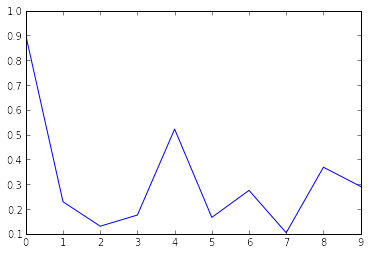

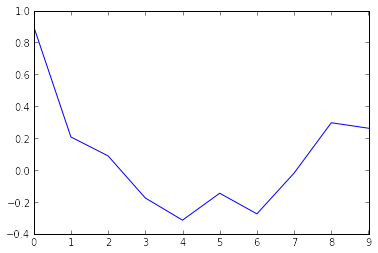

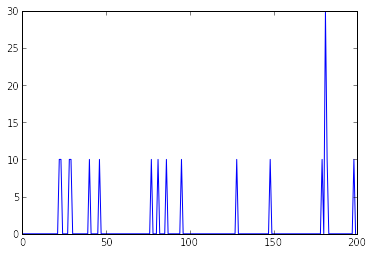

In [70]:
print len(asl.get_asl_by_id(spike_ids[0]))
import numpy.fft
pylab.plot(numpy.abs(numpy.fft.fft(asl.get_asl_by_id(spike_ids[0])))[:10]/200)
pylab.figure()
pylab.plot(numpy.fft.rfft(asl.get_asl_by_id(spike_ids[0]))[:10]/200)
pylab.figure()
pylab.plot(asl.get_asl_by_id(spike_ids[0]))
print numpy.mean(asl.get_asl_by_id(spike_ids[0]))

In [37]:
asl = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name=['F1(psth (bin=10.0) trial-to-trial mean)'],analysis_algorithm='Analog_F0andF1',sheet_name=['V1_Exc_L4']).get_analysis_result()[0]
pylab.hist(asl.get_value_by_id(spike_ids))


IndexError: list index out of range

In [ ]:
sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/mozaik/analysis')
import vision
reload(vision)

print vision.__file__

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',y_axis_name='psth (bin=10.0) trial-to-trial mean',sheet_name=['V1_Exc_L4','V1_Exc_L2/3','V1_Inh_L4','V1_Inh_L2/3'])   
vision.Analog_F0andF1(dsv,ParameterSet({})).analyse()



/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/mozaik/analysis/vision.pyc


  Starting Analog_F0andF1 analysis
Analog_F0andF1 analysis took: 79.1947259903seconds


In [40]:
dsv = queries.param_filter_query(data_store,value_name=['orientation CV(F1(psth (bin=10.0) trial-to-trial mean))'],sheet_name='V1_Exc_L4',st_contrast=[100]).print_content()   

  DSV info:
     Number of recordings: 0
     Number of ADS: 0


In [57]:
dsv = queries.param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='Analog_F0andF1')
TrialMean(dsv,ParameterSet({'cond_exc' : False, 'vm' : False, 'cond_inh' : False})).analyse()

  Starting TrialMean analysis
TrialMean analysis took: 9.83408904076seconds


L4Exc Mean HWHH: 26.336975588


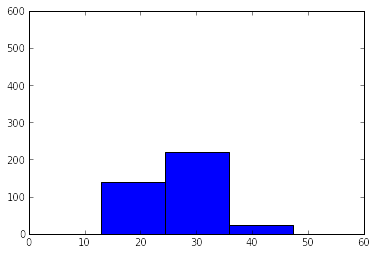

In [10]:
dsv = queries.param_filter_query(data_store,value_name=['orientation HWHH of F1(psth (bin=10.0) trial-to-trial mean)'],sheet_name=['V1_Exc_L4'],st_contrast=[10])    
a = numpy.array(dsv.get_analysis_result()[0].get_value_by_id(spike_ids))
pylab.hist(a)
pylab.xlim(0,60)
print "L4Exc Mean HWHH:", numpy.mean(a[a>0])

In [36]:
dsv = queries.param_filter_query(data_store,value_name=['F1(psth (bin=10.0) trial-to-trial mean)'],st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='Analog_F0andF1')
PlotTuningCurve(dsv, ParameterSet({'parameter_name' : 'orientation', 'neurons': list(analog_ids_inh), 'sheet_name' : 'V1_Inh_L4','centered'  : True,'mean' : True,'pool' : False,'polar' : False})).plot()

ValueError: max() arg is an empty sequence

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': (0, 0, 0), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 100'}
PlotTuningCurve plotting took: 0.0742449760437seconds


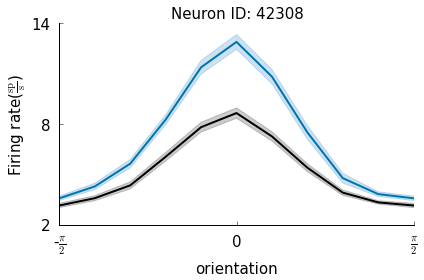

In [9]:
dsv = queries.param_filter_query(data_store,value_name=['Firing rate'],st_name='FullfieldDriftingSinusoidalGrating')
PlotTuningCurve(dsv, ParameterSet({'parameter_name' : 'orientation', 'neurons': list(analog_ids_inh), 'sheet_name' : 'V1_Inh_L4','centered'  : True,'mean' : True,'pool' : False,'polar' : False})).plot()

In [6]:
param_filter_query(data_store,analysis_algorithm="PopulationMeanAndVar",identifier='SingleValue',sheet_name='V1_Exc_L4').print_content(full_ADS=True)

  DSV info:
     Number of recordings: 0
     Number of ADS: 4
       SingleValue : 4
  ANALYSIS RESULTS
  {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":134400, "frame_duration":134400, "name":\'InternalStimulus\', "trial":None}', "value":1.9753720647802346, "value_name":'Var(Firing rate)'}
  {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":134400, "frame_duration":134400, "name":\'InternalStimulus\', "trial":0}', "value":0.040418438754382099, "value_name":'Var(CV of ISI squared)'}
  {"module_path"

In [13]:
param_filter_query(data_store,analysis_algorithm="NeuronToNeuronAnalogSignalCorrelations").print_content(full_ADS=True)

  DSV info:
     Number of recordings: 2532
       InternalStimulus : 12
       NaturalImageWithEyeMovement : 120
       FullfieldDriftingSinusoidalGrating : 2400
     Number of ADS: 0
  ANALYSIS RESULTS


In [22]:
dsv = param_filter_query(data_store,sheet_name='V1_Exc_L4',analysis_algorithm='PSTH',identifier='AnalogSignalList')

In [24]:
NeuronToNeuronAnalogSignalCorrelations(param_filter_query(data_store,sheet_name='V1_Exc_L4',analysis_algorithm='PSTH'),ParameterSet({'convert_nan_to_zero' : True})).analyse()

  Starting NeuronToNeuronAnalogSignalCorrelations analysis
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/numpy/lib/function_base.py:2124: RuntimeWarning: invalid value encountered in divide
  return c/sqrt(multiply.outer(d,d))
NeuronToNeuronAnalogSignalCorrelations analysis took: 66.8985431194seconds


0.967352453609 1.21731944602 0.0068626026217 0.00990824530943
0.955856499702 1.03685569849 0.0023643897671 0.00359704187713


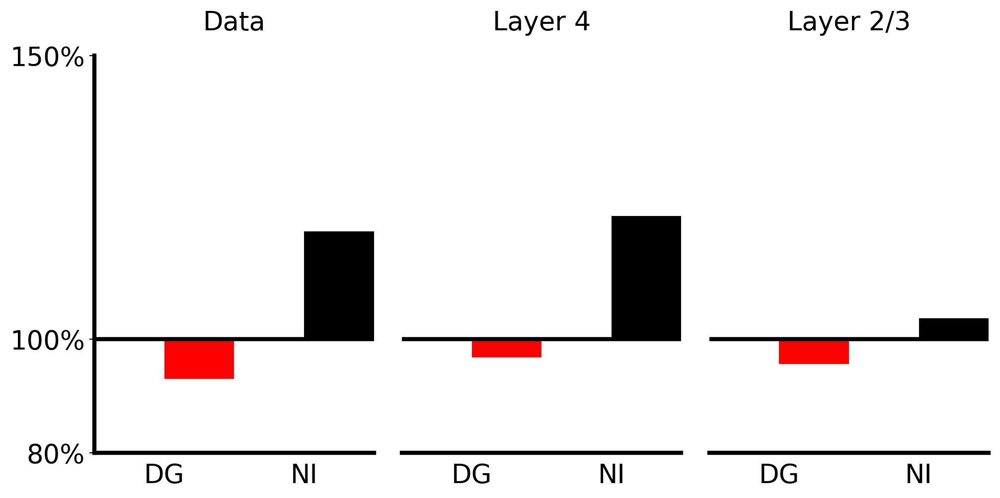

In [8]:
reload(lsv1m_paper)
lsv1m_paper.TrialToTrialVariabilityComparisonNew(data_store,ParameterSet({'sheet_name1' : 'V1_Exc_L4','sheet_name2' : 'V1_Exc_L2/3','data_dg' : 0.93 , 'data_ni' : 1.19}),fig_param={'dpi' : 200,'figsize': (10,5)},plot_file_name='TrialToTrialVariabilityComparison.png').plot()

[0.92346297773428254, 0.96040597792710292, 1.0018970593714902, 0.97689265424129612, 0.86230185878189058, 0.99927972324897418, 0.8748017070875459, 0.9163893804956339, 0.8811462233978381, 0.8655145642316282, 0.95737659484560289, 0.96555359779243122, 0.98301863677582602, 0.86527008098143043, 0.99810513813463886, 0.90059393504084395, 0.95311527637289373, 0.9987126064078482, 0.934866807260611, 0.96459125188654915, 0.84165223065582861, 0.89547206007358737, 0.96261707042151756, 0.97085692650829081, 0.93372774640677092, 0.98373588397020495, 0.93034816286303945, 0.98303112065086273, 0.99066678174914624, 0.97590092411768381, 0.93377298673677411, 0.91845531414112935, 0.98046093637156473, 0.95901478331931356, 0.91399696250017515, 0.90276833709638304, 0.95538936821544096, 0.95882204962975492, 0.98812995772380219, 0.98320033973862464]
[0.94811219275118086, 0.97929310072461706, 0.93473851059904867, 0.98431407199412901, 0.96186354571028998, 0.94480531469378415, 0.88588966172980654, 0.93780764698009988

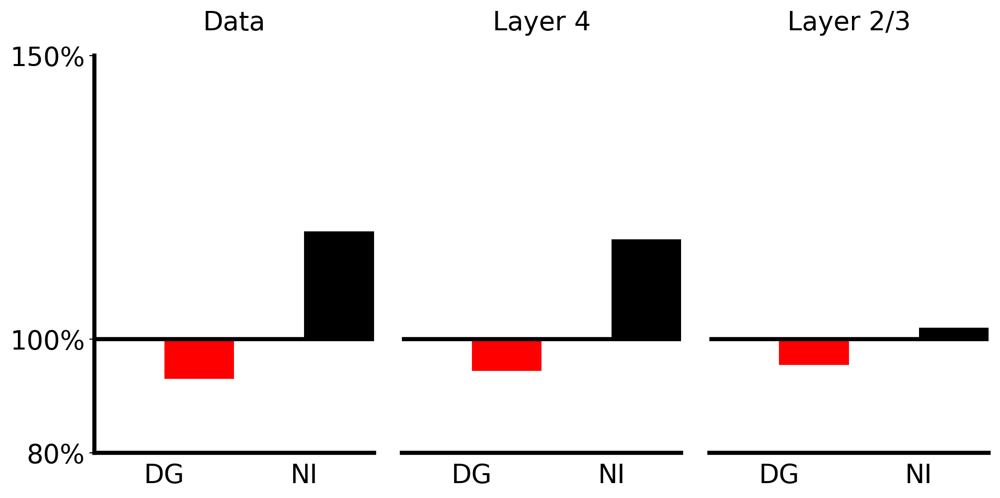

In [3]:
reload(lsv1m_paper)
lsv1m_paper.TrialToTrialVariabilityComparisonNew(data_store,ParameterSet({'sheet_name1' : 'V1_Exc_L4','sheet_name2' : 'V1_Exc_L2/3','data_dg' : 0.93 , 'data_ni' : 1.19}),fig_param={'dpi' : 200,'figsize': (10,5)},plot_file_name='TrialToTrialVariabilityComparison.png').plot()

In [19]:
a = [1.0104246219625519, 0.9234696641672635, 0.92027447397732776, 0.97302393757369687, 0.92309556887637811, 0.97367033957712257, 0.986829190456885, 0.95860656934544042, 0.98595209965846509, 0.99379627141748261, 1.0281580237380634, 0.97334909655177826, 1.0012817905612665, 0.99892101074037776, 0.88082650644885563, 0.96427251362408506, 0.90658869757288474, 0.95873706781361523, 0.99253982169665245, 0.93147292535236415, 0.93645786933873054, 0.9715977873952667, 0.93076311895724895, 0.96431144612412956, 0.94949847216952687, 1.0478333483708233, 0.90193828205054438, 0.94889541254192866, 1.0219527795789964, 0.95229426769569836, 0.9522258646647529, 0.98474740419168338, 0.96021043544414542, 0.98756491201154128, 0.92111139162671729, 1.0686081643710788, 1.0003187852423576, 1.0008783004077446, 1.0370281843768288, 0.87057172668130345]
len(a)
print numpy.mean(a)
print numpy.std(a)
print numpy.std(a)/numpy.sqrt(len(a))

0.967352453609
0.0434029099224
0.0068626026217


In [37]:
print lsv1m_paper.__file__

/home/antolikjan/projects/mozaikold/contrib/lsv1m_paper.py


In [ ]:
reload(lsv1m_paper)
lsv1m_paper.TrialCrossCorrelationAnalysis(data_store,ParameterSet({'neurons1' : list(analog_ids),'sheet_name1' : 'V1_Exc_L4','neurons2' : list(analog_ids23),'sheet_name2' : 'V1_Exc_L2/3', 'window_length' : 250}),fig_param={"dpi" : 100,"figsize": (15,6.5)},plot_file_name="trial-to-trial-cross-correlation.png").plot({'*.Vm.title' : None, '*.fontsize' : 19})

In [ ]:
reload(lsv1m_paper)
lsv1m_paper.TrialCrossCorrelationAnalysis(data_store,ParameterSet({'neurons1' : list(l4_exc_or_many_analog),'sheet_name1' : 'V1_Exc_L4','neurons2' : list(l23_exc_or_many_analog),'sheet_name2' : 'V1_Exc_L2/3', 'window_length' : 250}),fig_param={"dpi" : 100,"figsize": (15,6.5)},plot_file_name="trial-to-trial-cross-correlation.png").plot({'*.Vm.title' : None, '*.fontsize' : 19})

In [ ]:
reload(lsv1m_paper)
lsv1m_paper.TrialCrossCorrelationAnalysis(data_store,ParameterSet({'neurons1' : list(l4_exc_or_many_analog_inh),'sheet_name1' : 'V1_Inh_L4','neurons2' : list(l23_exc_or_many_analog_inh),'sheet_name2' : 'V1_Inh_L2/3', 'window_length' : 250}),fig_param={"dpi" : 100,"figsize": (15,6.5)},plot_file_name="trial-to-trial-cross-correlation.png").plot({'*.Vm.title' : None, '*.fontsize' : 19})

StimulusResponseComparison plotting took: 10.4410059452seconds


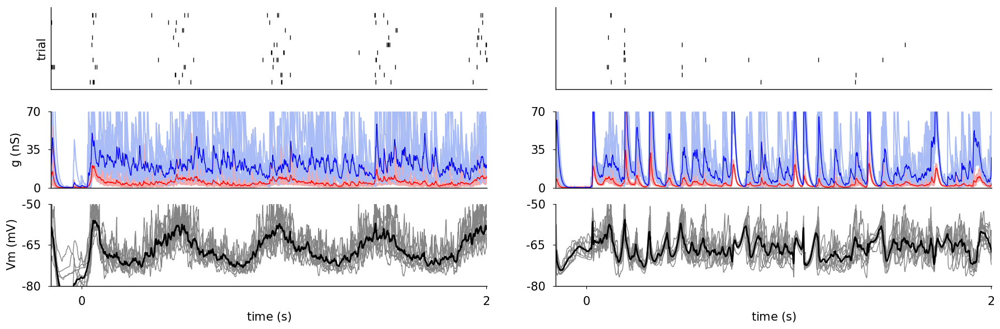

In [11]:
lsv1m_paper.StimulusResponseComparison(data_store,ParameterSet({'neuron' : l4_exc_or_many_analog[19],'sheet_name' : 'V1_Exc_L4'}),fig_param={'dpi' : 100,'figsize': (18,6)},plot_file_name='StimulusResponseComparison1L23.png').plot(

                                     {'*.x_ticks':[0,2.0], 
                                     "*.title" : None,
                                     '*.Vm_plot.y_lim' : (-80,-50),
                                     '*.Conductance_plot.y_lim' : (0,70),
                                    # '*.Conductance_plot.low_pass' : False,
                                     }
)

OverviewPlot plotting took: 0.631435155869seconds


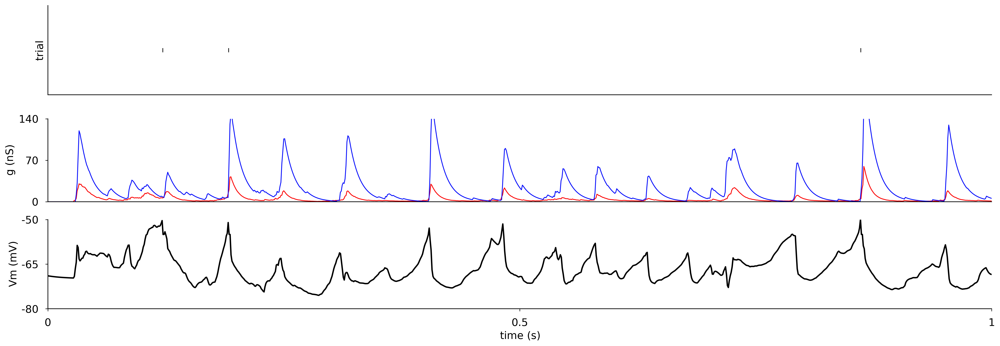

In [5]:
dsv=queries.param_filter_query(data_store,st_name='NaturalImageWithEyeMovement',st_trial=0)
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : l4_exc_or_many_analog[19] ,'sheet_activity' : {}, 'spontaneous' : False}),fig_param={'dpi' : 300,'figsize': (20,7)}).plot({'*.x_lim' : (0.0,1.0),'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,140), '*.x_ticks' : None})
